# Проект создания модели по имитации технологического процесса для металлургического комбината «Стальная птица».

Николай привет , вот щас в ответной форме(загрузить файл) подцепилось.

До этого пытался через форму писало превышен лимит на размер , а если через хаб пытался загрузить то просто висло все.

## Цели исследования

- Разработка пилотной версии прогнозной модели для определения требуемых температурных режимов сплавления металлов.


- Оценка экономического потенциала от внедрения модели.

## Ход исследования

- Подключение базы данных заказчика.


- Загрузка и первичное ознакомление с представленными табличными данными.


- Подготовка и обработка датасетов для формирования тренировочной выборки.


- Обучение моделей разного семейства для сравнительного теста.


- Выявление основных факторов влияющих на целевую переменную.



- Финальный вывод и рекомендации на основании полученных результатов.


## Описание данных

**steel.data_arc** — данные об электродах
- **key** — номер партии
- **BeginHeat** — время начала нагрева
- **EndHeat** — время окончания нагрева
- **ActivePower** — значение активной мощности
- **ReactivePower** — значение реактивной мощности

**steel.data_bulk** — данные об объёме сыпучих материалов
- **key** — номер партии
- **Bulk1 … Bulk15** — объём подаваемого материала

**steel.data_bulk_time** — данные о времени подачи сыпучих материалов
- **key** — номер партии
- **Bulk1 … Bulk15** — время подачи материала

**steel.data_gas** — данные о продувке сплава газом
- **key** — номер партии
- **gas** — объём подаваемого газа

**steel.data_temp** — данные об измерениях температуры
- **key** — номер партии
- **MesaureTime** — время замера
- **Temperature** — значение температуры

**steel.data_wire** — данные об объёме проволочных материалов
- **key** — номер партии
- **Wire1 … Wire9** — объём подаваемых проволочных материалов

**steel.data_wire_time** — данные о времени подачи проволочных материалов
- **key** — номер партии
- **Wire1 … Wire9** — время подачи проволочных материалов

## Техническая секция

### Импорты библиотек

In [3]:
# Основные библиотеки для работы с данными
import pandas as pd
import numpy as np
import json
import warnings
import random
import copy
import time
import os
import re
from pathlib import Path

# Визуализация
import plotly.graph_objects as go
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.ticker as ticker
import matplotlib.image as mpimg
import seaborn as sns

# Базы данных
from sqlalchemy import create_engine, inspect
import sqlite3

# Машинное обучение и обработка данных
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, cross_validate
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, accuracy_score,\
      classification_report, confusion_matrix, f1_score, roc_auc_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, SGDRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.dummy import DummyRegressor

# Статистика
from statsmodels.stats.outliers_influence import variance_inflation_factor
import phik

# EDA
from ydata_profiling import ProfileReport

# TensorFlow/Keras для нейронных сетей
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models, regularizers, optimizers
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam

# Гиперпараметрическая оптимизация
from keras_tuner import BayesianOptimization, Objective

# Сериализация
import joblib
import pickle

### Кастомные функции

In [4]:
def graph_num(df, columns, title, xlabel, bins=30):
    """
    Визуализирует числовые данные с помощью гистограммы и boxplot.

    Параметры:
    -----------
    df : pandas.DataFrame
        DataFrame, содержащий данные для анализа.
    columns : str
        Название столбца с числовыми данными, которые будут визуализированы.
    title : str
        Заголовок графика (добавляется к описанию гистограммы и boxplot).
    xlabel : str
        Подпись оси X для гистограммы.
    bins : int, optional
        Количество интервалов (бинов) для гистограммы. По умолчанию 30.
    """
    fig, ax = plt.subplots(1, 2, figsize=(15,5))
    sns.histplot(data=df, x=columns, kde=True, color='blue', bins=bins, ax=ax[0])
    ax[0].set_title('Гистограмма признака '+ title)
    ax[0].set_xlabel(xlabel)
    ax[0].set_ylabel('Кол-во')
    
    sns.boxplot(data=df[columns], orient='h', ax=ax[1])
    ax[1].set_title('Разброс значений признака '+ title)
    ax[1].set_xlabel('Значения')
    ax[1].set_ylabel(' ')


In [5]:
def export_all_tables_to_dataframes(db_path):
    """
    Экспортирует все таблицы из SQLite базы в словарь DataFrame
    
    Args:
        db_path (str): Путь к файлу базы данных
        
    Returns:
        dict: Словарь {имя_таблицы: DataFrame}
    """
    engine = create_engine(f'sqlite:///{db_path}')
    inspector = inspect(engine)
    
    all_dataframes = {}
    
    for table_name in inspector.get_table_names():
        if table_name.startswith('sqlite_'):
            continue
            
        print(f"Обрабатываю таблицу: {table_name}")
        
        columns = inspector.get_columns(table_name)
        print(f"  Столбцы: {[col['name'] for col in columns]}")
        
        df = pd.read_sql_table(table_name, engine)
        
        pk = inspector.get_pk_constraint(table_name)
        if pk['constrained_columns']:
            print(f"  Первичный ключ: {pk['constrained_columns']}")
        
        indexes = inspector.get_indexes(table_name)
        if indexes:
            print(f"  Индексы: {[idx['name'] for idx in indexes]}")
        
        all_dataframes[table_name] = df
        print(f"  Загружено: {len(df)} строк\n")
    
    engine.dispose()
    return all_dataframes

### Определение констант

In [6]:
test_size = 0.25
RS = 13012026
%matplotlib inline
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)


### Определение путей.

In [7]:
path_to_db = 'ds-plus-final.db'

## Загрузка и первичное ознакомление с  данными

### Загрузка базы данных заказчика.

Проверим содержание базы данных заказчика для оценки доступных нам данных.

In [8]:
dfs = export_all_tables_to_dataframes('ds-plus-final.db')

for table_name, df in dfs.items():
    print(f"Таблица: {table_name}")
    print(df.info())
    print("=" * 60)

Обрабатываю таблицу: contract
  Столбцы: ['customerID', 'BeginDate', 'EndDate', 'Type', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges']
  Загружено: 7043 строк

Обрабатываю таблицу: data_arc
  Столбцы: ['key', 'Начало нагрева дугой', 'Конец нагрева дугой', 'Активная мощность', 'Реактивная мощность']
  Загружено: 14876 строк

Обрабатываю таблицу: data_bulk
  Столбцы: ['key', 'Bulk 1', 'Bulk 2', 'Bulk 3', 'Bulk 4', 'Bulk 5', 'Bulk 6', 'Bulk 7', 'Bulk 8', 'Bulk 9', 'Bulk 10', 'Bulk 11', 'Bulk 12', 'Bulk 13', 'Bulk 14', 'Bulk 15']
  Загружено: 3129 строк

Обрабатываю таблицу: data_bulk_time
  Столбцы: ['key', 'Bulk 1', 'Bulk 2', 'Bulk 3', 'Bulk 4', 'Bulk 5', 'Bulk 6', 'Bulk 7', 'Bulk 8', 'Bulk 9', 'Bulk 10', 'Bulk 11', 'Bulk 12', 'Bulk 13', 'Bulk 14', 'Bulk 15']
  Загружено: 3129 строк

Обрабатываю таблицу: data_gas
  Столбцы: ['key', 'Газ 1']
  Загружено: 3239 строк

Обрабатываю таблицу: data_temp
  Столбцы: ['key', 'Время замера', 'Температура']
  Загружено: 18092 

In [9]:
dfs.keys()

dict_keys(['contract', 'data_arc', 'data_bulk', 'data_bulk_time', 'data_gas', 'data_temp', 'data_wire', 'data_wire_time', 'internet', 'personal', 'phone'])

Как видим  помимо указанных в тех.описании таблиц присутствует другая сопутствующая информация. 

Если в данных присутствует информация о затратах на производство, это может быть полезно при расчете экономического эффекта от внедрения моделей.

### Выгрузка датасетов и первичное ознакомление.

Сохраним каждую таблицу отдельно в датафрейм.

In [10]:
for key in dfs:
    df = pd.DataFrame(dfs[key])
        
    globals()[key] = df
        
    print(f"Создан DataFrame: {key} с формой {df.shape}")

Создан DataFrame: contract с формой (7043, 8)
Создан DataFrame: data_arc с формой (14876, 5)
Создан DataFrame: data_bulk с формой (3129, 16)
Создан DataFrame: data_bulk_time с формой (3129, 16)
Создан DataFrame: data_gas с формой (3239, 2)
Создан DataFrame: data_temp с формой (18092, 3)
Создан DataFrame: data_wire с формой (3081, 10)
Создан DataFrame: data_wire_time с формой (3081, 10)
Создан DataFrame: internet с формой (5517, 8)
Создан DataFrame: personal с формой (7043, 5)
Создан DataFrame: phone с формой (6361, 2)


### Первичное ознакомление.

In [11]:
data_arc.head(20)

,key,Начало нагрева дугой,Конец нагрева дугой,Активная мощность,Реактивная мощность
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.305130,0.211253
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.765658,0.477438
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.580313,0.430460
3,1,2019-05-03 11:18:14,2019-05-03 11:24:19,0.518496,0.379979
4,1,2019-05-03 11:26:09,2019-05-03 11:28:37,0.867133,0.643691
5,2,2019-05-03 11:34:14,2019-05-03 11:36:31,0.381124,0.220351
6,2,2019-05-03 11:38:50,2019-05-03 11:44:28,0.261665,0.205527
7,2,2019-05-03 11:46:19,2019-05-03 11:48:25,0.710297,0.484962
8,2,2019-05-03 11:49:48,2019-05-03 11:53:18,0.786322,0.542517
9,3,2019-05-03 12:06:54,2019-05-03 12:11:34,1.101678,0.820856


In [12]:
data_bulk.head(20)

,key,Bulk 1,Bulk 2,Bulk 3,Bulk 4,Bulk 5,Bulk 6,Bulk 7,Bulk 8,Bulk 9,Bulk 10,Bulk 11,Bulk 12,Bulk 13,Bulk 14,Bulk 15
0,1,NaN,NaN,NaN,43.0,None,None,None,None,None,None,None,206.0,None,150.0,154.0
1,2,NaN,NaN,NaN,73.0,None,None,None,None,None,None,None,206.0,None,149.0,154.0
2,3,NaN,NaN,NaN,34.0,None,None,None,None,None,None,None,205.0,None,152.0,153.0
3,4,NaN,NaN,NaN,81.0,None,None,None,None,None,None,None,207.0,None,153.0,154.0
4,5,NaN,NaN,NaN,78.0,None,None,None,None,None,None,None,203.0,None,151.0,152.0
5,6,NaN,NaN,NaN,117.0,None,None,None,None,None,None,None,204.0,None,201.0,154.0
6,7,NaN,NaN,NaN,117.0,None,None,None,None,None,None,None,204.0,None,152.0,154.0
7,8,NaN,NaN,NaN,99.0,None,None,None,None,None,None,None,410.0,None,252.0,153.0
8,9,NaN,NaN,NaN,117.0,None,None,None,None,None,None,None,107.0,None,99.0,203.0
9,10,NaN,NaN,NaN,NaN,None,None,None,None,None,None,None,203.0,None,102.0,204.0


In [13]:
ProfileReport(data_bulk , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 16/16 [00:00<00:00, 49.45it/s]


In [14]:
data_bulk_time.head(20)

,key,Bulk 1,Bulk 2,Bulk 3,Bulk 4,Bulk 5,Bulk 6,Bulk 7,Bulk 8,Bulk 9,Bulk 10,Bulk 11,Bulk 12,Bulk 13,Bulk 14,Bulk 15
0,1,None,None,None,2019-05-03 11:28:48,None,None,None,None,None,None,None,2019-05-03 11:24:31,None,2019-05-03 11:14:50,2019-05-03 11:10:43
1,2,None,None,None,2019-05-03 11:36:50,None,None,None,None,None,None,None,2019-05-03 11:53:30,None,2019-05-03 11:48:37,2019-05-03 11:44:39
2,3,None,None,None,2019-05-03 12:32:39,None,None,None,None,None,None,None,2019-05-03 12:27:13,None,2019-05-03 12:21:01,2019-05-03 12:16:16
3,4,None,None,None,2019-05-03 12:43:22,None,None,None,None,None,None,None,2019-05-03 12:58:00,None,2019-05-03 12:51:11,2019-05-03 12:46:36
4,5,None,None,None,2019-05-03 13:30:47,None,None,None,None,None,None,None,2019-05-03 13:30:47,None,2019-05-03 13:34:12,2019-05-03 13:30:47
5,6,None,None,None,2019-05-03 13:57:27,None,None,None,None,None,None,None,2019-05-03 13:48:52,None,2019-05-03 14:09:42,2019-05-03 14:03:15
6,7,None,None,None,2019-05-03 14:18:58,None,None,None,None,None,None,None,2019-05-03 14:41:26,None,2019-05-03 14:30:50,2019-05-03 14:27:16
7,8,None,None,None,2019-05-03 15:17:58,None,None,None,None,None,None,None,2019-05-03 15:17:58,None,2019-05-03 15:13:18,2019-05-03 15:05:33
8,9,None,None,None,2019-05-03 16:03:08,None,None,None,None,None,None,None,2019-05-03 16:03:08,None,2019-05-03 16:00:16,2019-05-03 15:52:39
9,10,None,None,None,None,None,None,None,None,None,None,None,2019-05-03 16:38:11,None,2019-05-03 16:34:24,2019-05-03 16:29:56


In [15]:
ProfileReport(data_bulk_time , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 16/16 [00:00<00:00, 96.33it/s]


In [16]:
data_gas.head(20)

,key,Газ 1
0,1,29.749986
1,2,12.555561
2,3,28.554793
3,4,18.841219
4,5,5.413692
5,6,11.273392
6,7,9.836267
7,8,15.171553
8,9,8.216623
9,10,6.529891


In [17]:
ProfileReport(data_gas , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 2/2 [00:00<00:00, 362.33it/s]


In [18]:
ProfileReport(data_temp , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 3/3 [00:00<00:00, 32.08it/s]


In [19]:
data_wire.head(20)

,key,Wire 1,Wire 2,Wire 3,Wire 4,Wire 5,Wire 6,Wire 7,Wire 8,Wire 9
0,1,60.059998,None,None,None,None,None,None,None,None
1,2,96.052315,None,None,None,None,None,None,None,None
2,3,91.160157,None,None,None,None,None,None,None,None
3,4,89.063515,None,None,None,None,None,None,None,None
4,5,89.238236,9.11456,None,None,None,None,None,None,None
5,6,99.109917,9.11456,None,None,None,None,None,None,None
6,7,98.061600,None,None,None,None,None,None,None,None
7,8,155.282394,None,None,None,None,None,None,None,None
8,9,113.393279,9.143681,None,None,None,None,None,None,None
9,10,81.244796,12.376,None,None,None,None,None,None,None


In [20]:
ProfileReport(data_wire , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 10/10 [00:00<00:00, 636.21it/s]


In [21]:
data_wire_time.head(20)

,key,Wire 1,Wire 2,Wire 3,Wire 4,Wire 5,Wire 6,Wire 7,Wire 8,Wire 9
0,1,2019-05-03 11:06:19,None,None,None,None,None,None,None,None
1,2,2019-05-03 11:36:50,None,None,None,None,None,None,None,None
2,3,2019-05-03 12:11:46,None,None,None,None,None,None,None,None
3,4,2019-05-03 12:43:22,None,None,None,None,None,None,None,None
4,5,2019-05-03 13:20:44,2019-05-03 13:15:34,None,None,None,None,None,None,None
5,6,2019-05-03 13:57:27,2019-05-03 13:48:52,None,None,None,None,None,None,None
6,7,2019-05-03 14:18:58,None,None,None,None,None,None,None,None
7,8,2019-05-03 15:01:30,None,None,None,None,None,None,None,None
8,9,2019-05-03 15:45:44,2019-05-03 15:39:37,None,None,None,None,None,None,None
9,10,2019-05-03 16:27:00,2019-05-03 16:22:36,None,None,None,None,None,None,None


In [22]:
ProfileReport(data_wire_time , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 10/10 [00:00<00:00, 97.28it/s]


### Анализ доп.данных.

In [23]:
contract

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges
0,7590-VHVEG,2020-01-01,No,Month-to-month,Yes,Electronic check,29.85,31.04
1,5575-GNVDE,2017-04-01,No,One year,No,Mailed check,56.95,2071.84
2,3668-QPYBK,2019-10-01,No,Month-to-month,Yes,Mailed check,53.85,226.17
3,7795-CFOCW,2016-05-01,No,One year,No,Bank transfer (automatic),42.3,1960.6
4,9237-HQITU,2019-09-01,No,Month-to-month,Yes,Electronic check,70.7,353.5
...,...,...,...,...,...,...,...,...
7038,6840-RESVB,2018-02-01,No,One year,Yes,Mailed check,84.8,2035.2
7039,2234-XADUH,2014-02-01,No,One year,Yes,Credit card (automatic),103.2,7430.4
7040,4801-JZAZL,2019-03-01,No,Month-to-month,Yes,Electronic check,29.6,325.6
7041,8361-LTMKD,2019-07-01,No,Month-to-month,Yes,Mailed check,74.4,520.8


In [24]:
ProfileReport(contract , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 8/8 [00:00<00:00, 52.23it/s]


In [25]:
internet.head(20)

,customerID,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies
0,7590-VHVEG,DSL,No,Yes,No,No,No,No
1,5575-GNVDE,DSL,Yes,No,Yes,No,No,No
2,3668-QPYBK,DSL,Yes,Yes,No,No,No,No
3,7795-CFOCW,DSL,Yes,No,Yes,Yes,No,No
4,9237-HQITU,Fiber optic,No,No,No,No,No,No
5,9305-CDSKC,Fiber optic,No,No,Yes,No,Yes,Yes
6,1452-KIOVK,Fiber optic,No,Yes,No,No,Yes,No
7,6713-OKOMC,DSL,Yes,No,No,No,No,No
8,7892-POOKP,Fiber optic,No,No,Yes,Yes,Yes,Yes
9,6388-TABGU,DSL,Yes,Yes,No,No,No,No


In [26]:
ProfileReport(internet , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 8/8 [00:00<00:00, 287.08it/s]


In [27]:
personal.head(20)

,customerID,gender,SeniorCitizen,Partner,Dependents
0,7590-VHVEG,Female,0,Yes,No
1,5575-GNVDE,Male,0,No,No
2,3668-QPYBK,Male,0,No,No
3,7795-CFOCW,Male,0,No,No
4,9237-HQITU,Female,0,No,No
5,9305-CDSKC,Female,0,No,No
6,1452-KIOVK,Male,0,No,Yes
7,6713-OKOMC,Female,0,No,No
8,7892-POOKP,Female,0,Yes,No
9,6388-TABGU,Male,0,No,Yes


In [28]:
ProfileReport(personal , title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 5/5 [00:00<00:00, 50.47it/s]


In [29]:
phone.head(20)

,CustomerId,MultipleLines
0,5575-GNVDE,No
1,3668-QPYBK,No
2,9237-HQITU,No
3,9305-CDSKC,Yes
4,1452-KIOVK,Yes
5,7892-POOKP,Yes
6,6388-TABGU,No
7,9763-GRSKD,No
8,7469-LKBCI,No
9,8091-TTVAX,Yes


In [30]:
ProfileReport(phone, title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 2/2 [00:00<00:00, 55.30it/s]


### Вывод

**1. Загрузка и структурирование данных**
- Успешно подключились к базе данных `ds-plus-final.db`
- Выгрузили все доступные таблицы в формате DataFrame
- Идентифицировали 10 таблиц в базе данных:
  - Основные таблицы (указанные в тех.описании): `data_arc`, `data_bulk`, `data_bulk_time`, `data_gas`, `data_temp`, `data_wire`, `data_wire_time`
  - Дополнительные таблицы: `contract`, `internet`, `personal`, `phone`

**2. Первичный анализ структуры данных**
- Для каждой таблицы выполнен обзор структуры с помощью `.info()`
- Созданы отдельные DataFrame для всех таблиц с автоматическим присвоением имен
- Проведен анализ размерности каждой таблицы

**3. Детальный EDA основных таблиц**
**Таблица `data_arc` (данные дуговой печи):**
- Содержит данные о мощности и времени работы
- Включает активную и реактивную мощность
- Имеет временные метки начала и окончания циклов

**Таблица `data_bulk` (сыпучие материалы):**
- Содержит информацию о добавлении сыпучих материалов (15 позиций)
- Обнаружены пропуски данных, которые означают отсутствие добавления материала
- Данные представлены в числовом формате

**Таблица `data_bulk_time` (время добавления сыпучих):**
- Содержит временные метки добавления материалов
- Соответствует структуре `data_bulk`
- Позволяет анализировать временные интервалы между добавлениями

**Таблица `data_gas` (газ):**
- Содержит данные о расходе газа
- Обнаружены аномально высокие значения (>24 у.е.)
- Требует дополнительного анализа на предмет корреляции с другими параметрами

**Таблица `data_temp` (температура):**
- Содержит целевой параметр - температуру
- Выявлены пропуски данных для ключей ≥2500
- Для этих ключей доступна только начальная температура

**Таблица `data_wire` (проволочные материалы):**
- Аналогична `data_bulk`, но для проволочных материалов (9 позиций)
- Также содержатся пропуски, означающие отсутствие добавления

**Таблица `data_wire_time` (время добавления проволоки):**
- Временные метки добавления проволочных материалов
- Коррелирует с данными из `data_wire`

**4. Анализ дополнительных таблиц**
**Таблица `contract` (договоры):**
- Содержит коммерческую информацию о договорах
- Может быть полезна для расчета экономических показателей
- Включает даты, суммы, условия договоров

**Таблица `internet` (интернет-услуги):**
- Содержит данные о расходах на интернет-услуги
- Потенциально полезна для анализа непроизводственных затрат

**Таблица `personal` (персонал):**
- Включает информацию о сотрудниках предприятия
- Может содержать данные о квалификации, должностях, стаже
- Потенциально полезна для анализа человеческого фактора

**Таблица `phone` (телефонные услуги):**
- Содержит данные о расходах на связь
- Как и `internet`, полезна для анализа накладных расходов

**5. Ключевые выводы**
- **Единый ключ**: Все производственные таблицы имеют столбец `key` для объединения данных
- **Дополнительные данные**: Обнаружены таблицы с финансовой и административной информацией, которые могут быть полезны для экономического анализа
- **Пропуски данных**: Выявлены системные пропуски в температурных данных и данных о материалах
- **Аномалии**: Обнаружены аномальные значения в расходе газа
- **Структурная целостность**: Временные таблицы корректно соответствуют таблицам материалов

## Исследовательский анализ и обработка дефектов.

### data_arc

Приведем название столбцов к принятому формату.

In [31]:
data_arc.columns

Index(['key', 'Начало нагрева дугой', 'Конец нагрева дугой',
       'Активная мощность', 'Реактивная мощность'],
      dtype='object')

In [32]:
data_arc.columns = ['key', 'start_time', 'stop_time', 'activ_pw', 'reactive_pw']

Так же приведем временные метки к подходящему типу данных.

In [33]:
data_arc[['start_time', 'stop_time']] = data_arc[['start_time', 'stop_time']].apply(pd.to_datetime)

In [34]:
data_arc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14876 entries, 0 to 14875
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   key          14876 non-null  int64         
 1   start_time   14876 non-null  datetime64[ns]
 2   stop_time    14876 non-null  datetime64[ns]
 3   activ_pw     14876 non-null  float64       
 4   reactive_pw  14876 non-null  float64       
dtypes: datetime64[ns](2), float64(2), int64(1)
memory usage: 581.2 KB


На этапе исследовательского анализа были замечены аномалии в данных.

In [35]:
data_arc.describe().T

,count,mean,min,25%,50%,75%,max,std
key,14876.0,1615.220422,1.0,806.0,1617.0,2429.0,3241.0,934.571502
start_time,14876,2019-07-05 12:25:51.921081088,2019-05-03 11:02:14,2019-06-03 23:18:23.249999872,2019-07-03 01:31:26.500000,2019-08-07 22:52:20.750000128,2019-09-06 17:24:54,NaN
stop_time,14876,2019-07-05 12:28:43.592027392,2019-05-03 11:06:02,2019-06-03 23:21:35,2019-07-03 01:35:13,2019-08-07 22:56:47,2019-09-06 17:26:15,NaN
activ_pw,14876.0,0.662752,0.22312,0.467115,0.599587,0.83007,1.463773,0.258885
reactive_pw,14876.0,0.438986,-715.479924,0.337175,0.441639,0.608201,1.270284,5.873485


Видим аномальное значение *Реактивная мощность* в -715.479924 , изучим это подробней.

In [36]:
data_arc[data_arc['reactive_pw'] < 0]

,key,start_time,stop_time,activ_pw,reactive_pw
9780,2116,2019-07-28 02:22:08,2019-07-28 02:23:57,0.705344,-715.479924


Видим что всего лишь в одной из строк присутствует дефект. 

Посмотрим на соотношение reactive_pw к activ_pw , для определения возможности восстановления примерного значения.

In [37]:
data_graph = data_arc.copy()
data_graph.drop(9780, axis=0, inplace=True)

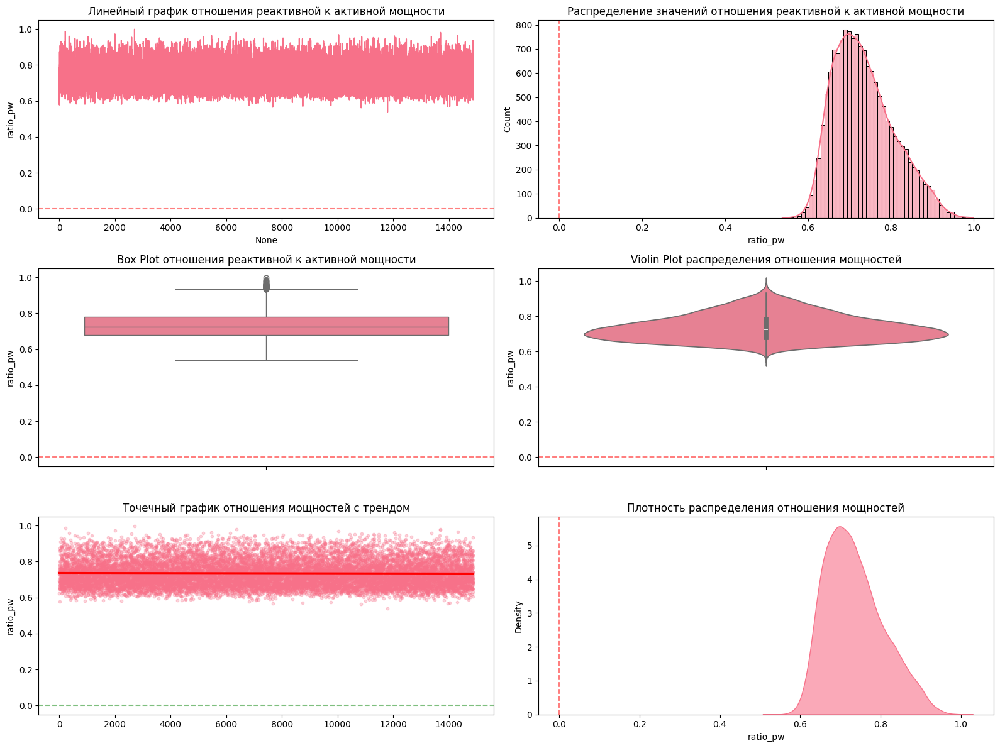

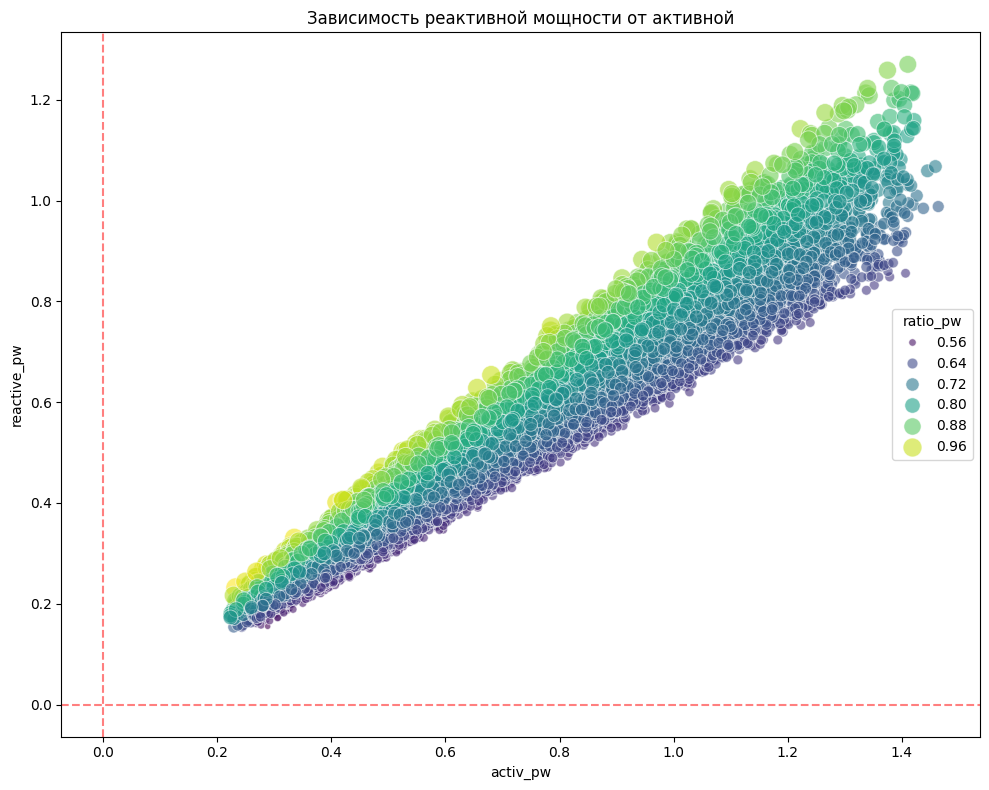

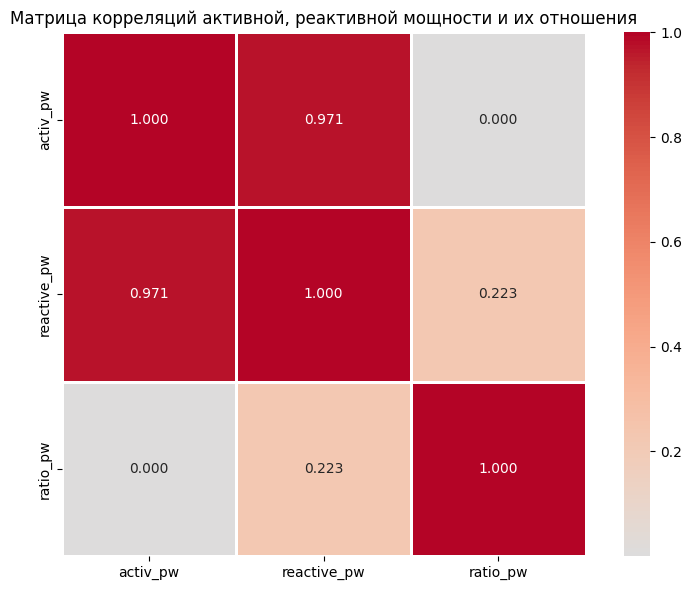


Статистика отношения реактивной мощности к активной:
count    14875.000000
mean         0.734924
std          0.072417
min          0.538375
25%          0.679709
50%          0.724759
75%          0.781170
max          0.998261
Name: ratio_pw, dtype: float64


In [38]:
data_graph['ratio_pw'] = data_graph['reactive_pw'] / data_graph['activ_pw']

sns.set_palette("husl") 

fig, axes = plt.subplots(3, 2, figsize=(16, 12))

sns.lineplot(data=data_graph, x=data_graph.index, y='ratio_pw', ax=axes[0, 0], ci=95)
axes[0, 0].set_title('Линейный график отношения реактивной к активной мощности')
axes[0, 0].axhline(y=0, color='red', linestyle='--', alpha=0.5)

sns.histplot(data=data_graph, x='ratio_pw', kde=True, ax=axes[0, 1], bins=50)
axes[0, 1].set_title('Распределение значений отношения реактивной к активной мощности')
axes[0, 1].axvline(x=0, color='red', linestyle='--', alpha=0.5)

sns.boxplot(data=data_graph, y='ratio_pw', ax=axes[1, 0])
axes[1, 0].set_title('Box Plot отношения реактивной к активной мощности')
axes[1, 0].axhline(y=0, color='red', linestyle='--', alpha=0.5)

sns.violinplot(data=data_graph, y='ratio_pw', ax=axes[1, 1])
axes[1, 1].set_title('Violin Plot распределения отношения мощностей')
axes[1, 1].axhline(y=0, color='red', linestyle='--', alpha=0.5)

sns.regplot(data=data_graph, x=data_graph.index, y='ratio_pw', ax=axes[2, 0], 
            scatter_kws={'alpha':0.3, 's':10}, line_kws={'color':'red'})
axes[2, 0].set_title('Точечный график отношения мощностей с трендом')
axes[2, 0].axhline(y=0, color='green', linestyle='--', alpha=0.5)

sns.kdeplot(data=data_graph, x='ratio_pw', ax=axes[2, 1], fill=True, alpha=0.6)
axes[2, 1].set_title('Плотность распределения отношения мощностей')
axes[2, 1].axvline(x=0, color='red', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

fig, ax = plt.subplots(figsize=(10, 8))
sns.scatterplot(data=data_graph, x='activ_pw', y='reactive_pw', 
                hue='ratio_pw', size='ratio_pw', sizes=(20, 200), 
                alpha=0.6, ax=ax, palette='viridis')
ax.set_title('Зависимость реактивной мощности от активной')
ax.axhline(y=0, color='red', linestyle='--', alpha=0.5)
ax.axvline(x=0, color='red', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(figsize=(8, 6))
correlation_matrix = data_graph[['activ_pw', 'reactive_pw', 'ratio_pw']].corr('spearman')
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, 
            square=True, linewidths=1, ax=ax, fmt='.3f')
ax.set_title('Матрица корреляций активной, реактивной мощности и их отношения')
plt.tight_layout()
plt.show()

print("\nСтатистика отношения реактивной мощности к активной:")
print(data_graph['ratio_pw'].describe())

Видим что соотношение коллеблится в диапазоне 0.53-0.99.

Учитывая что данные о мощности уже предположительно стандартизированны , сделаем предположение что значение в -715.479924 является либо не обработанным значением либо опечаткой в данных.

Что бы не терять данные приведем значение -715.479924 к формату 0.715479.

In [39]:
data_arc.loc[9780, 'reactive_pw'] = 0.715479
data_arc.loc[9780]

key                           2116
start_time     2019-07-28 02:22:08
stop_time      2019-07-28 02:23:57
activ_pw                  0.705344
reactive_pw               0.715479
Name: 9780, dtype: object

Проверим даты начала и конца нагрева стержней , на адекватность(дата конца была позже начала).

In [40]:
valid_rows = data_arc['start_time'] < data_arc['stop_time']
invalid_count = len(data_arc) - valid_rows.sum()
print(f'Кол-во аномальных строк : {invalid_count}')

Кол-во аномальных строк : 0


Видим что с временными данными все в порядке.

Рассмотрим распределение наших числовых переменных.

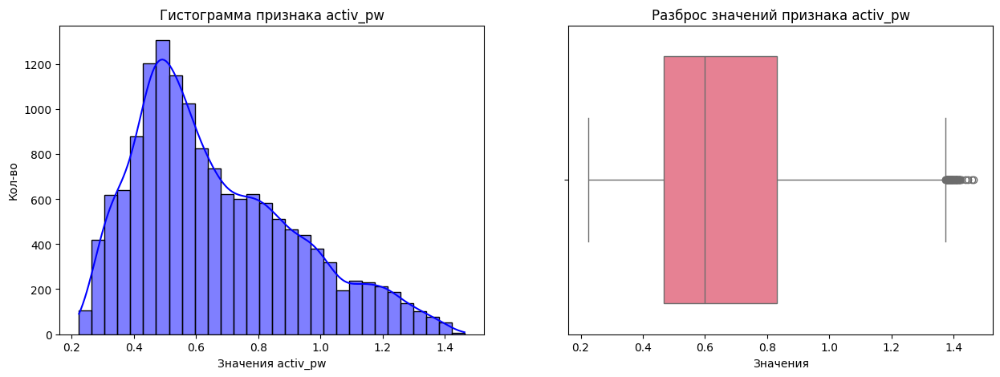

In [41]:
graph_num(data_arc, 'activ_pw', 'activ_pw', 'Значения activ_pw')

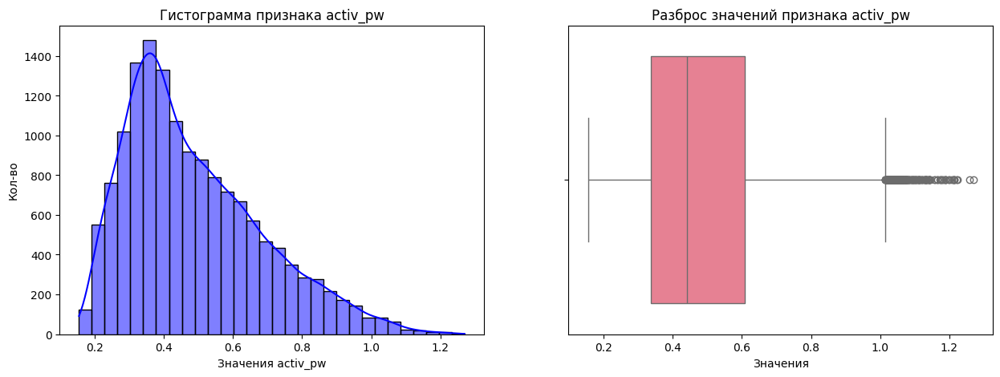

In [42]:
graph_num(data_arc, 'reactive_pw', 'activ_pw', 'Значения activ_pw')

In [43]:
data_arc

,key,start_time,stop_time,activ_pw,reactive_pw
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.305130,0.211253
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.765658,0.477438
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.580313,0.430460
3,1,2019-05-03 11:18:14,2019-05-03 11:24:19,0.518496,0.379979
4,1,2019-05-03 11:26:09,2019-05-03 11:28:37,0.867133,0.643691
...,...,...,...,...,...
14871,3241,2019-09-06 16:49:05,2019-09-06 16:51:42,0.439735,0.299579
14872,3241,2019-09-06 16:55:11,2019-09-06 16:58:11,0.646498,0.458240
14873,3241,2019-09-06 17:06:48,2019-09-06 17:09:52,1.039726,0.769302
14874,3241,2019-09-06 17:21:58,2019-09-06 17:22:55,0.530267,0.361543


Убрав аномальное значение в *reactive_pw* данные приобрели адекватный вид , а так же каких либо расхождений в датах выявлено не было.

Можно переходить к созданию дополнительных фичей.

In [44]:
df_data_arc = data_arc.copy()

Создадим признак длительности нагрева в секундах.

In [45]:
df_data_arc['duration'] = (df_data_arc['stop_time'] - df_data_arc['start_time']).dt.total_seconds()
df_data_arc['duration'].head(20)

0     228.0
1     185.0
2     172.0
3     365.0
4     148.0
5     137.0
6     338.0
7     126.0
8     210.0
9     280.0
10    124.0
11    109.0
12     77.0
13     65.0
14    207.0
15     99.0
16    157.0
17    278.0
18    251.0
19    132.0
Name: duration, dtype: float64

In [46]:
df_data_arc['duration'].describe()

count    14876.000000
mean       171.670946
std         98.186803
min         11.000000
25%        107.000000
50%        147.000000
75%        214.000000
max        907.000000
Name: duration, dtype: float64

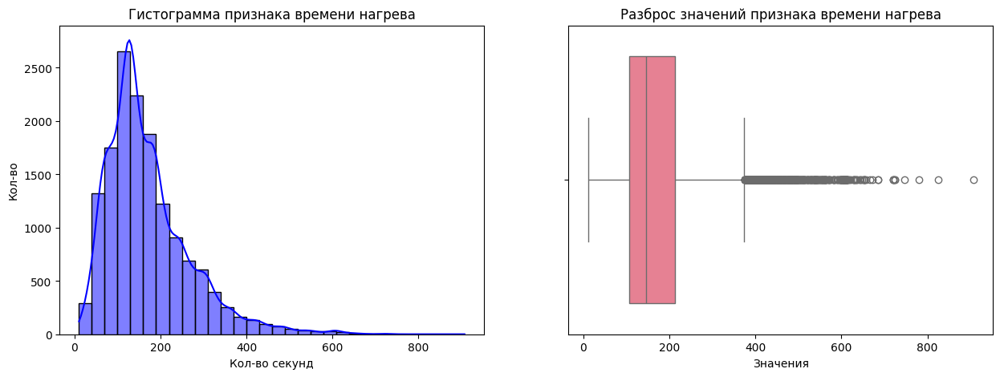

In [47]:
graph_num(df_data_arc, 'duration', 'времени нагрева', 'Кол-во секунд')

Получим признак часа в который преимущественно происходит нагрев.

Возможно удастся потенциально снизить расходы и нагрузку на эл-сеть если сместить основной цикл работы на ночное время.

In [48]:
df_data_arc['time_of_day'] = (df_data_arc['start_time']).dt.hour
df_data_arc['time_of_day'].head(15)

0     11
1     11
2     11
3     11
4     11
5     11
6     11
7     11
8     11
9     12
10    12
11    12
12    12
13    12
14    12
Name: time_of_day, dtype: int32

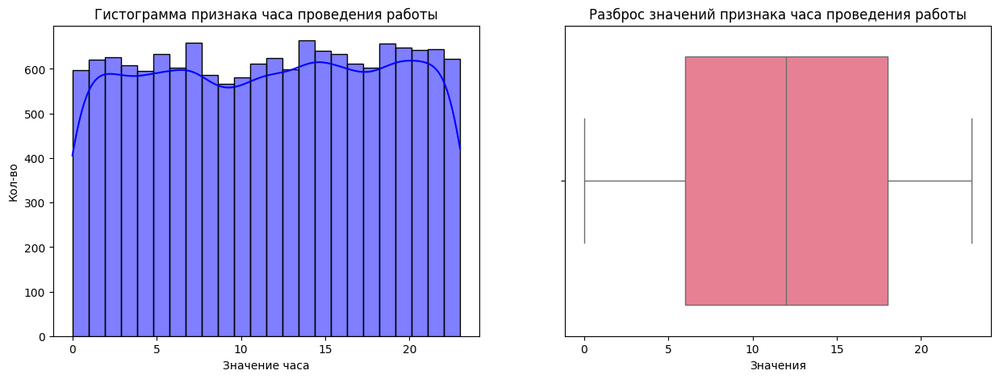

In [49]:
graph_num(df_data_arc, 'time_of_day', 'часа проведения работы', 'Значение часа', bins=24)

Видим что работа установки для нагрева металла равномерно распределена во времени.

Аналогичным образом посмотрим на день недели.

In [50]:
df_data_arc['day_of_week'] = (df_data_arc['start_time']).dt.weekday
df_data_arc['day_of_week'].head(15)

0     4
1     4
2     4
3     4
4     4
5     4
6     4
7     4
8     4
9     4
10    4
11    4
12    4
13    4
14    4
Name: day_of_week, dtype: int32

In [51]:
df_data_arc['day_of_week'].describe()

count    14876.000000
mean         3.014789
std          1.970757
min          0.000000
25%          1.000000
50%          3.000000
75%          5.000000
max          6.000000
Name: day_of_week, dtype: float64

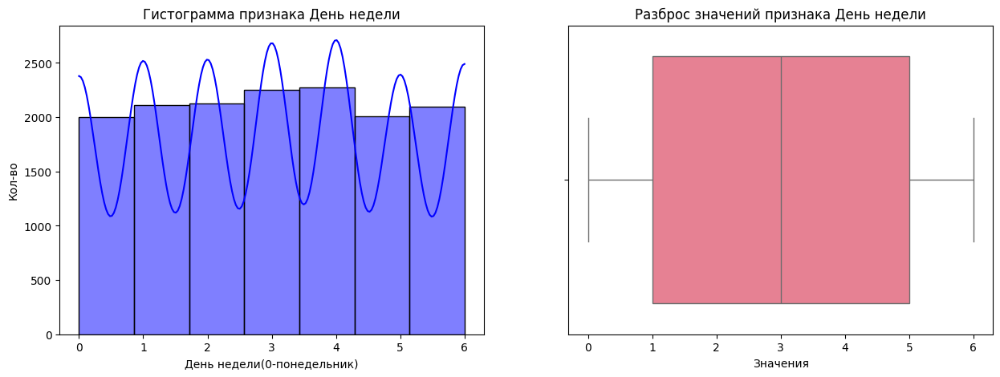

In [52]:
graph_num(df_data_arc, 'day_of_week', 'День недели', 'День недели(0-понедельник)', bins=7)

Из графиков так же видно что в целом нагрузка на установку не имеет явной корреляции с днем недели и распределена нормально.

Рассмотрим значения месяцев что бы посмотреть есть ли какая либо сезонная зависимость.

In [53]:
df_data_arc['month'] = (df_data_arc['start_time']).dt.month
df_data_arc['month'].head(15)

0     5
1     5
2     5
3     5
4     5
5     5
6     5
7     5
8     5
9     5
10    5
11    5
12    5
13    5
14    5
Name: month, dtype: int32

In [54]:
df_data_arc['month'].describe()

count    14876.000000
mean         6.649166
std          1.223962
min          5.000000
25%          6.000000
50%          7.000000
75%          8.000000
max          9.000000
Name: month, dtype: float64

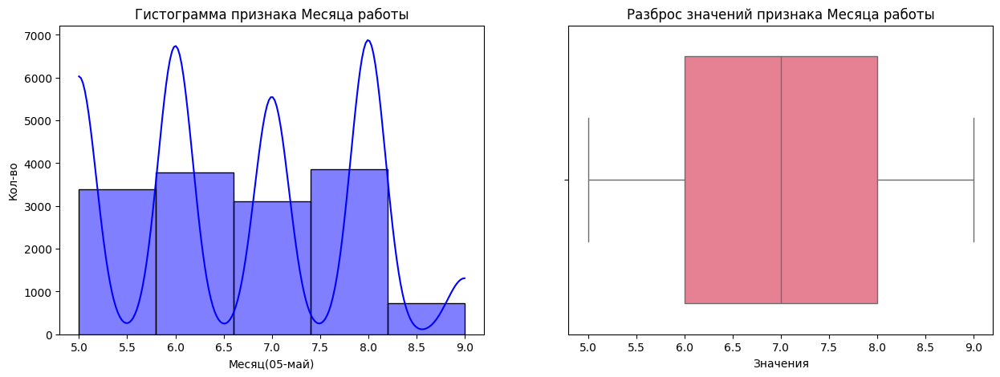

In [55]:
graph_num(df_data_arc, 'month', 'Месяца работы', 'Месяц(05-май)', bins=5)

In [56]:
df_data_arc['month'].value_counts()

month
8    3860
6    3783
5    3383
7    3115
9     735
Name: count, dtype: int64

Видим что в сентябре , установка работала значительно меньше.

Возможно это связанно с форматом данных , а возможно в этот период действительно предприятие работало меньше обычного из за внешних факторов.

Проверим за какой год предоставленные нам данные , а так же когда за сентябрь установка запускалась в последний раз.

In [57]:
df_data_arc['stop_time'].max()

Timestamp('2019-09-06 17:26:15')

Видим что последние данные за сентябрь датированы 06 числом , а значит данные за этот месяц не представлены полностью.

In [58]:
df_data_arc['year'] = (df_data_arc['start_time']).dt.year
df_data_arc['year'].head(15)

0     2019
1     2019
2     2019
3     2019
4     2019
5     2019
6     2019
7     2019
8     2019
9     2019
10    2019
11    2019
12    2019
13    2019
14    2019
Name: year, dtype: int32

In [59]:
df_data_arc['year'].value_counts()

year
2019    14876
Name: count, dtype: int64

Видим что все данные за один год , на основании этого предположим что наши данные просто предсталенны этим периодом и производство не носит никакой сезонности.

Перейдем к созданию признаков на основе данных о мощности.

In [60]:
# Так как наши данные нормализованны и в них нет отрицательных значений просто сложим мощности в место корня квадратного из суммы квадратов мощностей.
df_data_arc['apparent_power'] = df_data_arc['activ_pw'] + df_data_arc['reactive_pw']
df_data_arc['apparent_power'].head(15)

0     0.516383
1     1.243096
2     1.010773
3     0.898475
4     1.510824
5     0.601475
6     0.467192
7     1.195259
8     1.328839
9     1.922534
10    1.017348
11    1.280322
12    2.086639
13    0.694255
14    1.159017
Name: apparent_power, dtype: float64

In [61]:
df_data_arc['apparent_power'].describe()

count    14876.000000
mean         1.149883
std          0.452712
min          0.382629
25%          0.807373
50%          1.043635
75%          1.438178
max          2.680739
Name: apparent_power, dtype: float64

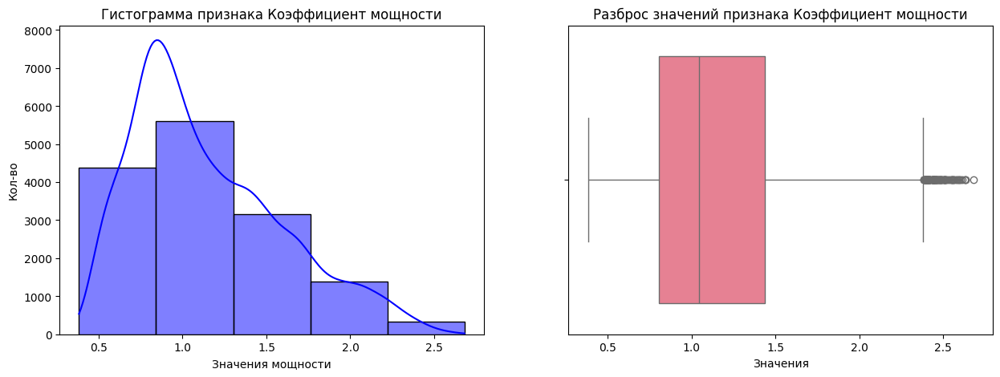

In [62]:
graph_num(df_data_arc, 'apparent_power', 'Коэффициент мощности', 'Значения мощности', bins=5)

In [63]:
# Коэффициент мощности = P / √(P² + Q²) в относительных единицах.

df_data_arc['power_factor'] = df_data_arc['activ_pw'] / np.sqrt(df_data_arc['activ_pw']**2 + df_data_arc['reactive_pw']**2)
df_data_arc['power_factor']

0        0.822181
1        0.848545
2        0.803161
3        0.806591
4        0.802950
           ...   
14871    0.826438
14872    0.815844
14873    0.803877
14874    0.826229
14875    0.839960
Name: power_factor, Length: 14876, dtype: float64

In [64]:
df_data_arc['power_factor'].describe()

count    14876.000000
mean         0.805880
std          0.027669
min          0.702045
25%          0.788046
50%          0.809703
75%          0.827038
max          0.880503
Name: power_factor, dtype: float64

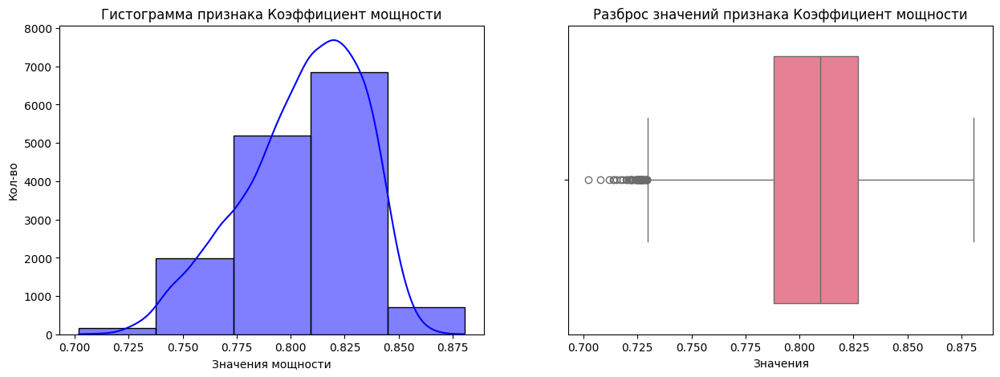

In [65]:
graph_num(df_data_arc, 'power_factor', 'Коэффициент мощности', 'Значения мощности', bins=5)

In [66]:
df_data_arc['reactive_to_active_ratio'] = df_data_arc['reactive_pw'] / (df_data_arc['activ_pw'])
df_data_arc['reactive_to_active_ratio'].head(15)

0     0.692338
1     0.623566
2     0.741772
3     0.732848
4     0.742321
5     0.578161
6     0.785459
7     0.682759
8     0.689943
9     0.745096
10    0.874691
11    0.652813
12    0.706216
13    0.646352
14    0.802666
Name: reactive_to_active_ratio, dtype: float64

Попытаемся создать относительную метрику нагрузки в минуту.

In [67]:
df_data_arc['load_intensity'] = (df_data_arc['activ_pw'] / (df_data_arc['duration'] / 60)).round(3)
df_data_arc['load_intensity'].head(15)

0     0.080
1     0.248
2     0.202
3     0.085
4     0.352
5     0.167
6     0.046
7     0.338
8     0.225
9     0.236
10    0.263
11    0.426
12    0.953
13    0.389
14    0.186
Name: load_intensity, dtype: float64

In [68]:
df_data_arc['load_intensity'].describe()

count    14876.000000
mean         0.322384
std          0.290044
min          0.022000
25%          0.156000
50%          0.246000
75%          0.395000
max          5.004000
Name: load_intensity, dtype: float64

Видим появление аномально высоких значений по сравнению с общей массой данных.

In [69]:
df_data_arc[df_data_arc['load_intensity'] > 1]

,key,start_time,stop_time,activ_pw,reactive_pw,duration,time_of_day,day_of_week,month,year,apparent_power,power_factor,reactive_to_active_ratio,load_intensity
174,38,2019-05-04 17:41:51,2019-05-04 17:42:28,0.633236,0.463029,37.0,17,5,5,2019,1.096265,0.807221,0.731211,1.027
189,43,2019-05-04 22:05:44,2019-05-04 22:06:41,1.014174,0.717038,57.0,22,5,5,2019,1.731212,0.816531,0.707017,1.068
200,44,2019-05-05 02:21:14,2019-05-05 02:21:41,0.916247,0.653412,27.0,2,6,5,2019,1.569659,0.814175,0.713140,2.036
288,62,2019-05-05 21:07:17,2019-05-05 21:08:27,1.237724,0.867720,70.0,21,6,5,2019,2.105444,0.818824,0.701061,1.061
462,99,2019-05-07 02:32:39,2019-05-07 02:33:44,1.207410,0.810785,65.0,2,1,5,2019,2.018195,0.830191,0.671508,1.115
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14474,3148,2019-09-03 10:07:09,2019-09-03 10:07:37,0.493367,0.328901,28.0,10,1,9,2019,0.822268,0.832058,0.666646,1.057
14544,3165,2019-09-03 21:40:21,2019-09-03 21:40:53,1.212264,1.097323,32.0,21,1,9,2019,2.309587,0.741380,0.905185,2.273
14627,3182,2019-09-04 16:30:36,2019-09-04 16:31:23,0.880846,0.674297,47.0,16,2,9,2019,1.555143,0.794049,0.765511,1.124
14727,3205,2019-09-05 11:14:15,2019-09-05 11:14:46,0.615719,0.490849,31.0,11,3,9,2019,1.106568,0.781937,0.797196,1.192


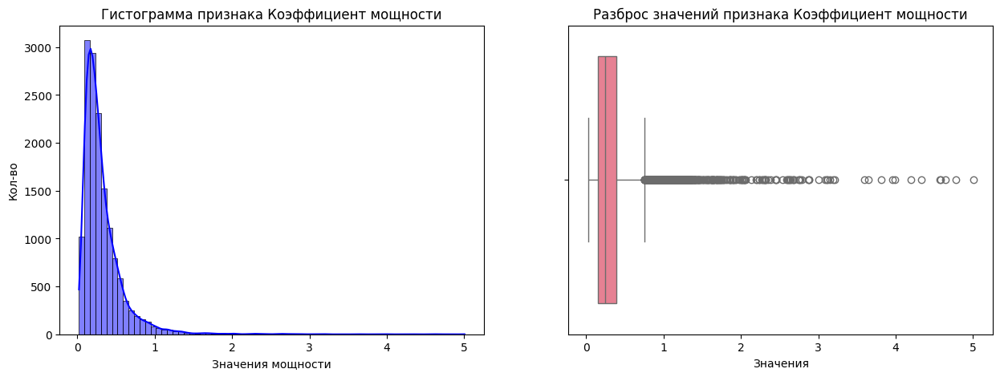

In [70]:
graph_num(df_data_arc, 'load_intensity', 'Коэффициент мощности', 'Значения мощности', bins=70)

Из за экстремально коротких включения установки , образовались аномальные значения , оставим их и посмотрим влияние на этапе построения модели.

### data_bulk

Из описания данных , нам известно что отсутствующие значения значит что этот материал не добавлялся в партию , поэтому заполним пропуски нулями.

In [71]:
df_data_bulk = data_bulk.copy()

Приведем названия колонок к подходящему виду.

In [72]:
df_data_bulk.columns = df_data_bulk.columns.str.replace(' ', '_')
df_data_bulk.columns = df_data_bulk.columns.str.lower()

In [73]:
df_data_bulk.columns

Index(['key', 'bulk_1', 'bulk_2', 'bulk_3', 'bulk_4', 'bulk_5', 'bulk_6',
       'bulk_7', 'bulk_8', 'bulk_9', 'bulk_10', 'bulk_11', 'bulk_12',
       'bulk_13', 'bulk_14', 'bulk_15'],
      dtype='object')

Так же переведем значения колонок bulk_* к подходящему типу данных.

In [74]:
df_data_bulk = df_data_bulk.apply(pd.to_numeric).astype('Int64')

In [75]:
df_data_bulk.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3129 entries, 0 to 3128
Data columns (total 16 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   key      3129 non-null   Int64
 1   bulk_1   252 non-null    Int64
 2   bulk_2   22 non-null     Int64
 3   bulk_3   1298 non-null   Int64
 4   bulk_4   1014 non-null   Int64
 5   bulk_5   77 non-null     Int64
 6   bulk_6   576 non-null    Int64
 7   bulk_7   25 non-null     Int64
 8   bulk_8   1 non-null      Int64
 9   bulk_9   19 non-null     Int64
 10  bulk_10  176 non-null    Int64
 11  bulk_11  177 non-null    Int64
 12  bulk_12  2450 non-null   Int64
 13  bulk_13  18 non-null     Int64
 14  bulk_14  2806 non-null   Int64
 15  bulk_15  2248 non-null   Int64
dtypes: Int64(16)
memory usage: 440.1 KB


In [76]:
df_data_bulk.isna().sum()

key           0
bulk_1     2877
bulk_2     3107
bulk_3     1831
bulk_4     2115
bulk_5     3052
bulk_6     2553
bulk_7     3104
bulk_8     3128
bulk_9     3110
bulk_10    2953
bulk_11    2952
bulk_12     679
bulk_13    3111
bulk_14     323
bulk_15     881
dtype: int64

In [77]:
df_data_bulk.fillna(0, inplace=True)
df_data_bulk.isna().sum()

key        0
bulk_1     0
bulk_2     0
bulk_3     0
bulk_4     0
bulk_5     0
bulk_6     0
bulk_7     0
bulk_8     0
bulk_9     0
bulk_10    0
bulk_11    0
bulk_12    0
bulk_13    0
bulk_14    0
bulk_15    0
dtype: int64

Создадим количественные фичи отражающие общий объем добавленного материала в партию.

In [78]:
cols_to_sum = [col for col in df_data_bulk.columns if col.startswith('bulk_')]

In [79]:
cols_to_sum

['bulk_1',
 'bulk_2',
 'bulk_3',
 'bulk_4',
 'bulk_5',
 'bulk_6',
 'bulk_7',
 'bulk_8',
 'bulk_9',
 'bulk_10',
 'bulk_11',
 'bulk_12',
 'bulk_13',
 'bulk_14',
 'bulk_15']

In [80]:
df_data_bulk['total_mat'] = df_data_bulk[cols_to_sum].sum(axis=1)
df_data_bulk['total_mat'].head(15)

0      553
1      582
2      544
3      595
4      584
5      676
6      627
7      914
8      526
9      509
10     579
11    1307
12     837
13     630
14     531
Name: total_mat, dtype: Int64

Добавим среднее значение добавленного материала.

In [81]:
df_data_bulk['mean_mat'] = (df_data_bulk['total_mat'] 
                            / df_data_bulk[[f'bulk_{i}' for i in range(1, 16)]].ne(0).sum(axis=1)).round(2)  #.replace(0, float('nan'))
df_data_bulk['mean_mat'].head(15)

0     138.25
1      145.5
2      136.0
3     148.75
4      146.0
5      169.0
6     156.75
7      228.5
8      131.5
9     169.67
10    144.75
11     261.4
12    209.25
13     157.5
14     177.0
Name: mean_mat, dtype: Float64

Добавим фичу кол-ва итераций добавления материалов.

In [82]:
df_data_bulk['cnt'] = df_data_bulk[[f'bulk_{i}' for i in range(1, 16)]].ne(0).sum(axis=1)

In [83]:
df_data_bulk.head(15)

,key,bulk_1,bulk_2,bulk_3,bulk_4,bulk_5,bulk_6,bulk_7,bulk_8,bulk_9,bulk_10,bulk_11,bulk_12,bulk_13,bulk_14,bulk_15,total_mat,mean_mat,cnt
0,1,0,0,0,43,0,0,0,0,0,0,0,206,0,150,154,553,138.25,4
1,2,0,0,0,73,0,0,0,0,0,0,0,206,0,149,154,582,145.5,4
2,3,0,0,0,34,0,0,0,0,0,0,0,205,0,152,153,544,136.0,4
3,4,0,0,0,81,0,0,0,0,0,0,0,207,0,153,154,595,148.75,4
4,5,0,0,0,78,0,0,0,0,0,0,0,203,0,151,152,584,146.0,4
5,6,0,0,0,117,0,0,0,0,0,0,0,204,0,201,154,676,169.0,4
6,7,0,0,0,117,0,0,0,0,0,0,0,204,0,152,154,627,156.75,4
7,8,0,0,0,99,0,0,0,0,0,0,0,410,0,252,153,914,228.5,4
8,9,0,0,0,117,0,0,0,0,0,0,0,107,0,99,203,526,131.5,4
9,10,0,0,0,0,0,0,0,0,0,0,0,203,0,102,204,509,169.67,3


### data_wire

Приведем названия столбцов к стандартному для нас формату.

In [84]:
df_data_wire = data_wire.copy()

In [85]:
df_data_wire.columns = df_data_wire.columns.str.replace(' ', '_')
df_data_wire.columns = df_data_wire.columns.str.lower()

In [86]:
df_data_wire.columns

Index(['key', 'wire_1', 'wire_2', 'wire_3', 'wire_4', 'wire_5', 'wire_6',
       'wire_7', 'wire_8', 'wire_9'],
      dtype='object')

В таблице *data_wire* аналогично *data_bulk* пресутсвуют пропуски , показывающие что данный материал не был добавлен.

Заменим все пропуски на 0.

In [87]:
df_data_wire.fillna(0, inplace=True)
df_data_wire.isna().sum()

key       0
wire_1    0
wire_2    0
wire_3    0
wire_4    0
wire_5    0
wire_6    0
wire_7    0
wire_8    0
wire_9    0
dtype: int64

In [88]:
df_data_wire.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3081 entries, 0 to 3080
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   key     3081 non-null   int64  
 1   wire_1  3081 non-null   float64
 2   wire_2  3081 non-null   object 
 3   wire_3  3081 non-null   object 
 4   wire_4  3081 non-null   object 
 5   wire_5  3081 non-null   object 
 6   wire_6  3081 non-null   object 
 7   wire_7  3081 non-null   object 
 8   wire_8  3081 non-null   object 
 9   wire_9  3081 non-null   object 
dtypes: float64(1), int64(1), object(8)
memory usage: 240.8+ KB


Так же переведем значения колонок wire_* к подходящему типу данных.

In [89]:
df_data_wire = df_data_wire.apply(pd.to_numeric).astype('float64')

Создадим аналогичные *data_bulk* количественные признаки.

In [90]:
cols_to_sum = [col for col in df_data_wire.columns if col.startswith('wire_')]

In [91]:
cols_to_sum

['wire_1',
 'wire_2',
 'wire_3',
 'wire_4',
 'wire_5',
 'wire_6',
 'wire_7',
 'wire_8',
 'wire_9']

In [92]:
df_data_wire['total_wire'] = df_data_wire[cols_to_sum].sum(axis=1)
df_data_wire['total_wire'].head(15)

0      60.059998
1      96.052315
2      91.160157
3      89.063515
4      98.352796
5     108.224477
6      98.061600
7     155.282394
8     122.536960
9      93.620796
10     99.197281
11    153.578873
12    129.685923
13    158.077919
14    123.381439
Name: total_wire, dtype: float64

Добавим среднее значение добавленной проволоки.

In [93]:
df_data_wire['mean_wire'] = (df_data_wire['total_wire'] 
                            / df_data_wire[[f'wire_{i}' for i in range(1, 10)]].ne(0).sum(axis=1)).round(2)  #.replace(0, float('nan'))
df_data_wire['mean_wire'].head(15)

0      60.06
1      96.05
2      91.16
3      89.06
4      49.18
5      54.11
6      98.06
7     155.28
8      61.27
9      46.81
10     99.20
11    153.58
12     64.84
13     79.04
14     61.69
Name: mean_wire, dtype: float64

Добавим фичу кол-ва итераций добавления проволоки.

In [94]:
df_data_wire['wire_cnt'] = df_data_wire[[f'wire_{i}' for i in range(1, 10)]].ne(0).sum(axis=1)
df_data_wire

,key,wire_1,wire_2,wire_3,wire_4,wire_5,wire_6,wire_7,wire_8,wire_9,total_wire,mean_wire,wire_cnt
0,1.0,60.059998,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60.059998,60.06,1
1,2.0,96.052315,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,96.052315,96.05,1
2,3.0,91.160157,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,91.160157,91.16,1
3,4.0,89.063515,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,89.063515,89.06,1
4,5.0,89.238236,9.11456,0.0,0.0,0.0,0.0,0.0,0.0,0.0,98.352796,49.18,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3076,3237.0,38.088959,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38.088959,38.09,1
3077,3238.0,56.128799,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,56.128799,56.13,1
3078,3239.0,143.357761,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,143.357761,143.36,1
3079,3240.0,34.070400,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,34.070400,34.07,1


### data_gas

Адаптируем названия колонок.

In [95]:
data_gas.columns = ['key', 'gas']

In [96]:
data_gas.columns

Index(['key', 'gas'], dtype='object')

Посмотрим на распределение переменной *gas*

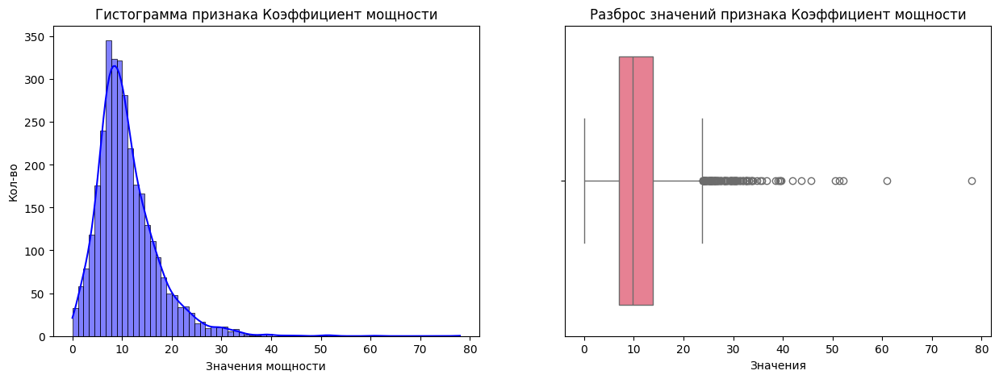

In [97]:
graph_num(data_gas, 'gas', 'Коэффициент мощности', 'Значения мощности', bins=70)

In [98]:
data_gas['gas'].describe()

count    3239.000000
mean       11.002062
std         6.220327
min         0.008399
25%         7.043089
50%         9.836267
75%        13.769915
max        77.995040
Name: gas, dtype: float64

Нашлось несколько аномально высоких значений посмотрим на их количественное распределение.

In [99]:
data_gas['gas'].astype('int').value_counts(ascending=True).head(20)

gas
50     1
60     1
52     1
45     1
51     1
36     1
41     1
77     1
43     1
34     2
38     2
35     2
39     3
27     5
33     5
32     6
31     6
29     9
30    11
28    11
Name: count, dtype: int64

Проанализируем строки в которых значение использования газа выходит за 24 у.е.

In [100]:
data_gas[data_gas['gas'] > 24]

,key,gas
0,1,29.749986
2,3,28.554793
105,106,33.213990
112,113,25.377930
116,117,50.581035
...,...,...
2847,2850,30.329044
2855,2858,30.499860
2858,2861,27.510774
2990,2993,30.355494


Сделаем предположение что кол-во газа может быть как то связанно с общим временем нагрева металла в установке.

Проверим это обьеденив таблицу data_gas с df_data_arc

In [101]:
group_dr = df_data_arc.groupby('key', as_index=False)['duration'].sum()

In [102]:
group_dr['duration_m'] = (group_dr['duration'] / 60).astype('int')

In [103]:
gas_check = pd.merge(data_gas, group_dr, on='key', how='left')

In [104]:
gas_check.head(10)

,key,gas,duration,duration_m
0,1,29.749986,1098.0,18.0
1,2,12.555561,811.0,13.0
2,3,28.554793,655.0,10.0
3,4,18.841219,741.0,12.0
4,5,5.413692,869.0,14.0
5,6,11.273392,952.0,15.0
6,7,9.836267,673.0,11.0
7,8,15.171553,913.0,15.0
8,9,8.216623,625.0,10.0
9,10,6.529891,825.0,13.0


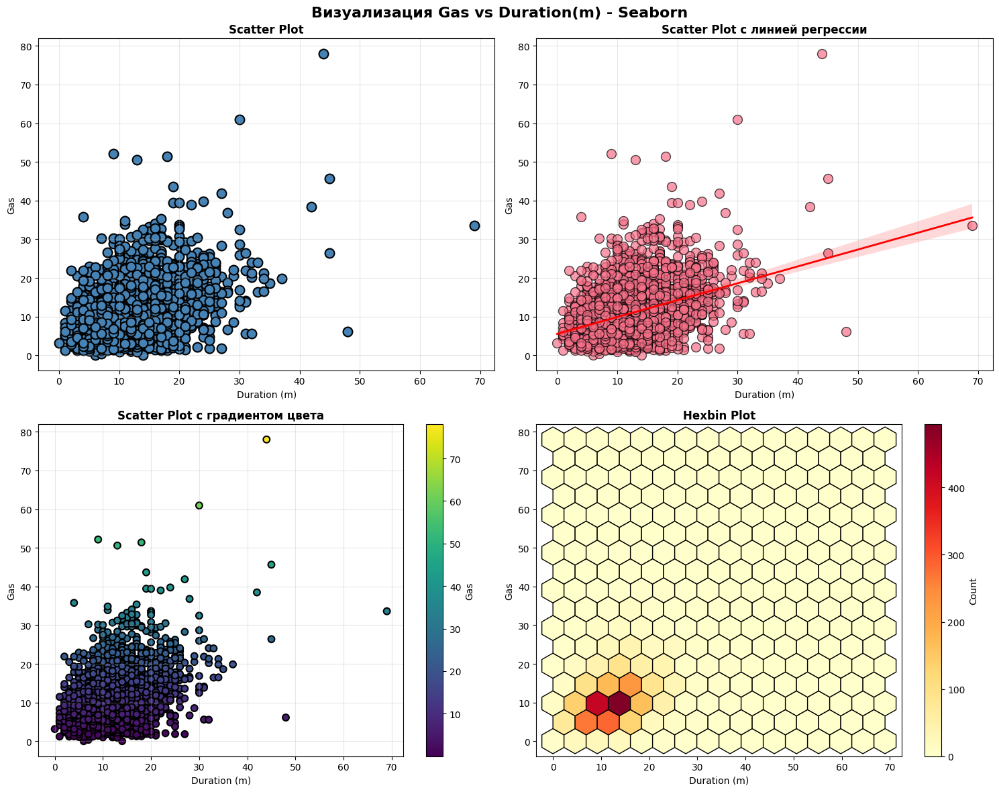

In [105]:
fig, axes = plt.subplots(2, 2, figsize=(15, 12))
fig.suptitle('Визуализация Gas vs Duration(m) - Seaborn', fontsize=16, fontweight='bold')

sns.scatterplot(data=gas_check, x='duration_m', y='gas', s=100, 
                color='steelblue', edgecolor='black', linewidth=1.5, ax=axes[0, 0])
axes[0, 0].set_title('Scatter Plot', fontsize=12, fontweight='bold')
axes[0, 0].set_xlabel('Duration (m)', fontsize=10)
axes[0, 0].set_ylabel('Gas', fontsize=10)
axes[0, 0].grid(True, alpha=0.3)

sns.regplot(data=gas_check, x='duration_m', y='gas', 
            scatter_kws={'s': 100, 'alpha': 0.7, 'edgecolor': 'black'},
            line_kws={'color': 'red', 'linewidth': 2},
            ax=axes[0, 1])
axes[0, 1].set_title('Scatter Plot с линией регрессии', fontsize=12, fontweight='bold')
axes[0, 1].set_xlabel('Duration (m)', fontsize=10)
axes[0, 1].set_ylabel('Gas', fontsize=10)
axes[0, 1].grid(True, alpha=0.3)

scatter = axes[1, 0].scatter(gas_check['duration_m'], gas_check['gas'], 
                            c=gas_check['gas'], s=50, cmap='viridis', 
                            edgecolor='black', linewidth=1.5)
axes[1, 0].set_title('Scatter Plot с градиентом цвета', fontsize=12, fontweight='bold')
axes[1, 0].set_xlabel('Duration (m)', fontsize=10)
axes[1, 0].set_ylabel('Gas', fontsize=10)
axes[1, 0].grid(True, alpha=0.3)
plt.colorbar(scatter, ax=axes[1, 0], label='Gas')

hexbin = axes[1, 1].hexbin(gas_check['duration_m'], gas_check['gas'], 
                          gridsize=15, cmap='YlOrRd', edgecolors='black')
axes[1, 1].set_title('Hexbin Plot', fontsize=12, fontweight='bold')
axes[1, 1].set_xlabel('Duration (m)', fontsize=10)
axes[1, 1].set_ylabel('Gas', fontsize=10)
plt.colorbar(hexbin, ax=axes[1, 1], label='Count')

plt.tight_layout()
plt.show()

In [106]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=gas_check['duration_m'],
    y=gas_check['gas'],
    mode='markers+lines+text',
    marker=dict(
        size=12,
        color=gas_check['gas'],
        colorscale='Viridis',
        showscale=True,
        colorbar=dict(title='Значение gas')
    ),
    text=gas_check['key'],
    textposition='top center',
    name='gas vs duration_m',
    hovertemplate='<b>Key:</b> %{text}<br>' +
                  '<b>duration_m:</b> %{x} мин<br>' +
                  '<b>gas:</b> %{y:.2f}<br>' +
                  '<b>duration:</b> %{customdata[0]:.0f} сек<br>' +
                  '<extra></extra>',
    customdata=gas_check[['duration']]
))

fig.update_layout(
    title='Зависимость gas от duration_m',
    title_x=0.5,
    xaxis_title='Duration (минуты)',
    yaxis_title='Gas',
    xaxis=dict(
        tickmode='linear',
        dtick=1,
        gridcolor='lightgray'
    ),
    yaxis=dict(
        gridcolor='lightgray'
    ),
    plot_bgcolor='white',
    hovermode='closest',
    width=800,
    height=500
)

fig.add_trace(go.Scatter(
    x=gas_check['duration_m'],
    y=pd.Series(gas_check['gas']).rolling(window=2, center=True).mean(),
    mode='lines',
    line=dict(color='red', width=2, dash='dash'),
    name='Тренд',
    showlegend=True
))

fig.show()

fig2 = px.scatter(
    gas_check, 
    x='duration_m', 
    y='gas',
    size='gas',
    color='gas',
    hover_data=['key', 'duration'],
    title='Зависимость gas от duration_m (альтернативный вариант)',
    labels={'duration_m': 'Duration (минуты)', 'gas': 'Gas'},
    trendline='lowess',  # сглаженная линия тренда
    trendline_color_override='red'
)

fig2.update_layout(
    title_x=0.5,
    width=800,
    height=500
)

fig2.show()

Видим что за исключением нескольких наблюдений , данные имеют линейную зависимость.

На данном этапе оставим *аномально* высокие значения как есть , вполне возможно что данные имеют реальную природу и такой тех. процесс необходим для изготовления определенного специфического металла.

### data_temp

Обработаем названия столбцов , уже привычным нам форматом.

In [107]:
data_temp.columns = ['key', 'measure_time', 'temp']

В таблице на этапе загрузки , мы обнаружили пропуски в столбце *temp*.

In [108]:
data_temp[data_temp['temp'].isna()].head(10)

,key,measure_time,temp
13927,2500,2019-08-10 14:13:11,None
13928,2500,2019-08-10 14:18:12,None
13929,2500,2019-08-10 14:25:53,None
13930,2500,2019-08-10 14:29:39,None
13932,2501,2019-08-10 14:49:15,None
13933,2501,2019-08-10 15:02:56,None
13934,2501,2019-08-10 15:07:47,None
13935,2501,2019-08-10 15:16:53,None
13936,2501,2019-08-10 15:22:50,None
13937,2501,2019-08-10 15:29:00,None


Видим что пропуски начинают фигурировать в данных с *ключа* 2500.

Рассмотрим этот срез данных более подробно.

In [109]:
temp_miss = data_temp[data_temp['key'] >= 2500]
temp_miss

,key,measure_time,temp
13926,2500,2019-08-10 14:04:39,1539.0
13927,2500,2019-08-10 14:13:11,None
13928,2500,2019-08-10 14:18:12,None
13929,2500,2019-08-10 14:25:53,None
13930,2500,2019-08-10 14:29:39,None
...,...,...,...
18087,3241,2019-09-06 16:55:01,None
18088,3241,2019-09-06 17:06:38,None
18089,3241,2019-09-06 17:21:48,None
18090,3241,2019-09-06 17:24:44,None


Проверим сколько вхождений замеров температуры есть для каждого из ключей (с учетом пропусков)

In [110]:
temp_miss.groupby('key')['temp'].size()

key
2500    5
2501    7
2502    5
2503    5
2504    6
       ..
3237    6
3238    4
3239    9
3240    6
3241    6
Name: temp, Length: 739, dtype: int64

In [111]:
temp_miss.groupby('key')['temp'].size().value_counts()

temp
5     204
6     179
4     125
7     102
8      53
3      38
9      18
10      7
2       7
12      2
11      2
15      1
13      1
Name: count, dtype: int64

Получим аналогичную информацию , но только для заполненых данных. (без учета пропусков)

In [112]:
temp_miss.groupby('key')['temp'].count()

key
2500    1
2501    1
2502    1
2503    1
2504    1
       ..
3237    1
3238    1
3239    1
3240    1
3241    1
Name: temp, Length: 739, dtype: int64

In [113]:
temp_miss.groupby('key')['temp'].count().unique()

array([1])

In [114]:
unique_keys_count = temp_miss.groupby('key').ngroups
unique_keys_count

739

Проверим только ли у первого замера есть значения температуры.

In [115]:
group_check = temp_miss.groupby('key').apply(
    lambda g: (g['temp'].iloc[0] is not None) and (g['temp'].iloc[1:].isna().all())
)

all_correct = group_check.all()

if all_correct:
    print("Все ключи удовлетворяют условию")
else:
    problem_keys = group_check[~group_check].index.tolist()
    print(f"Ключи с нарушениями: {problem_keys}")
    print(f"Всего нарушений: {len(problem_keys)}")

Все ключи удовлетворяют условию


C:\Users\para\AppData\Local\Temp\ipykernel_5740\4138986688.py:1: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [116]:
print(f"Процент данных с пропусками :  {((unique_keys_count / data_temp['key'].nunique())*100):.2f}%")

Процент данных с пропусками :  22.98%


Видим что для каждого ключа , есть только 1 наблюдение начальной температуры.

Учитывая, что столбец **temp** представляет целевой признак, а целевой переменной является последнее значение температуры, необходимо исключить проанализированный нами срез из выборки данных.

In [117]:
df_temp_filt = data_temp[~data_temp['key'].isin(group_check.reset_index()['key'])]


In [118]:
df_temp_filt['key'].describe()

count    13926.000000
mean      1243.530447
std        719.126684
min          1.000000
25%        624.000000
50%       1246.000000
75%       1870.000000
max       2499.000000
Name: key, dtype: float64

### data_bulk_time и data_wire_time.

Проверим временные даты на адекватность , для этого проделаем следующие шаги.

Проверим, чтобы каждому значению в столбцах bulk_1-15 соответствовало значение во связанном столбце времени bulk_1-15_time.



In [119]:
data_bulk.columns

Index(['key', 'Bulk 1', 'Bulk 2', 'Bulk 3', 'Bulk 4', 'Bulk 5', 'Bulk 6',
       'Bulk 7', 'Bulk 8', 'Bulk 9', 'Bulk 10', 'Bulk 11', 'Bulk 12',
       'Bulk 13', 'Bulk 14', 'Bulk 15'],
      dtype='object')

In [120]:
data_bulk_time.columns

Index(['key', 'Bulk 1', 'Bulk 2', 'Bulk 3', 'Bulk 4', 'Bulk 5', 'Bulk 6',
       'Bulk 7', 'Bulk 8', 'Bulk 9', 'Bulk 10', 'Bulk 11', 'Bulk 12',
       'Bulk 13', 'Bulk 14', 'Bulk 15'],
      dtype='object')

In [121]:
base_columns = [col for col in data_bulk.columns]

for col in base_columns:
    if col in data_bulk_time.columns:
        missing_mask = data_bulk[col].notna() & data_bulk_time[col].isna()
        if missing_mask.any():
            print(f"В столбце {col} найдены несоответствия:")
            print(data_bulk[missing_mask][[col, f'{col}_time']])
        else:
            print(f'В столбце {col} несоответствий не найдено')
    else:
        print(f"Столбец {col} отсутствует в data_bulk_time")

В столбце key несоответствий не найдено
В столбце Bulk 1 несоответствий не найдено
В столбце Bulk 2 несоответствий не найдено
В столбце Bulk 3 несоответствий не найдено
В столбце Bulk 4 несоответствий не найдено
В столбце Bulk 5 несоответствий не найдено
В столбце Bulk 6 несоответствий не найдено
В столбце Bulk 7 несоответствий не найдено
В столбце Bulk 8 несоответствий не найдено
В столбце Bulk 9 несоответствий не найдено
В столбце Bulk 10 несоответствий не найдено
В столбце Bulk 11 несоответствий не найдено
В столбце Bulk 12 несоответствий не найдено
В столбце Bulk 13 несоответствий не найдено
В столбце Bulk 14 несоответствий не найдено
В столбце Bulk 15 несоответствий не найдено


Проведем аналогичную процедуру с data_wire и data_wire_time 

In [122]:
data_wire.columns

Index(['key', 'Wire 1', 'Wire 2', 'Wire 3', 'Wire 4', 'Wire 5', 'Wire 6',
       'Wire 7', 'Wire 8', 'Wire 9'],
      dtype='object')

In [123]:
data_wire_time.columns

Index(['key', 'Wire 1', 'Wire 2', 'Wire 3', 'Wire 4', 'Wire 5', 'Wire 6',
       'Wire 7', 'Wire 8', 'Wire 9'],
      dtype='object')

In [124]:
base_columns = [col for col in data_wire.columns]

for col in base_columns:
    if col in data_wire_time.columns:
        missing_mask = data_wire[col].notna() & data_wire_time[col].isna()
        if missing_mask.any():
            print(f"В столбце {col} найдены несоответствия:")
            print(data_wire[missing_mask][[col, f'{col}_time']])
        else:
            print(f'В столбце {col} несоответствий не найдено')
    else:
        print(f"Столбец {col} отсутствует в data_wire_time")

В столбце key несоответствий не найдено
В столбце Wire 1 несоответствий не найдено
В столбце Wire 2 несоответствий не найдено
В столбце Wire 3 несоответствий не найдено
В столбце Wire 4 несоответствий не найдено
В столбце Wire 5 несоответствий не найдено
В столбце Wire 6 несоответствий не найдено
В столбце Wire 7 несоответствий не найдено
В столбце Wire 8 несоответствий не найдено
В столбце Wire 9 несоответствий не найдено


Видим что данные ликвидны , и каждой временной метке соответствует значения добавленного материала.

Попытаемся на основе имеющихся данных создать колонки временных интервалов смежных дат.

In [125]:
df_data_bulk_time = data_bulk_time.copy()

In [126]:
df_data_bulk_time.columns = df_data_bulk_time.columns.str.replace(' ', '_')
df_data_bulk_time.columns = df_data_bulk_time.columns.str.lower()

In [127]:
df_data_bulk_time.columns

Index(['key', 'bulk_1', 'bulk_2', 'bulk_3', 'bulk_4', 'bulk_5', 'bulk_6',
       'bulk_7', 'bulk_8', 'bulk_9', 'bulk_10', 'bulk_11', 'bulk_12',
       'bulk_13', 'bulk_14', 'bulk_15'],
      dtype='object')

In [128]:
date_columns = [col for col in df_data_bulk_time.columns if col.startswith('bulk_')]
for col in date_columns:
    df_data_bulk_time[col] = pd.to_datetime(df_data_bulk_time[col])


In [129]:
df_data_bulk_time.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3129 entries, 0 to 3128
Data columns (total 16 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   key      3129 non-null   int64         
 1   bulk_1   252 non-null    datetime64[ns]
 2   bulk_2   22 non-null     datetime64[ns]
 3   bulk_3   1298 non-null   datetime64[ns]
 4   bulk_4   1014 non-null   datetime64[ns]
 5   bulk_5   77 non-null     datetime64[ns]
 6   bulk_6   576 non-null    datetime64[ns]
 7   bulk_7   25 non-null     datetime64[ns]
 8   bulk_8   1 non-null      datetime64[ns]
 9   bulk_9   19 non-null     datetime64[ns]
 10  bulk_10  176 non-null    datetime64[ns]
 11  bulk_11  177 non-null    datetime64[ns]
 12  bulk_12  2450 non-null   datetime64[ns]
 13  bulk_13  18 non-null     datetime64[ns]
 14  bulk_14  2806 non-null   datetime64[ns]
 15  bulk_15  2248 non-null   datetime64[ns]
dtypes: datetime64[ns](15), int64(1)
memory usage: 391.3 KB


In [130]:
def calculate_interval_seconds(row):
    times = [t for t in row[date_columns].values if pd.notnull(t)]
    times.sort()
    
    intervals_seconds = []
    for i in range(1, len(times)):
        interval_seconds = (times[i] - times[i-1]).total_seconds()
        intervals_seconds.append(interval_seconds)
    
    return intervals_seconds

In [131]:
max_intervals = max(len(calculate_interval_seconds(df_data_bulk_time.iloc[i])) for i in range(len(df_data_bulk_time)))

for i in range(max_intervals):
    df_data_bulk_time[f'Interval_sec_{i+1}'] = np.nan

for idx in range(len(df_data_bulk_time)):
    intervals_seconds = calculate_interval_seconds(df_data_bulk_time.iloc[idx])
    
    for i, interval_sec in enumerate(intervals_seconds):
        df_data_bulk_time.at[idx, f'Interval_sec_{i+1}'] = interval_sec

In [132]:
df_data_bulk_time.head(20)

,key,bulk_1,bulk_2,bulk_3,bulk_4,bulk_5,bulk_6,bulk_7,bulk_8,bulk_9,...,bulk_12,bulk_13,bulk_14,bulk_15,Interval_sec_1,Interval_sec_2,Interval_sec_3,Interval_sec_4,Interval_sec_5,Interval_sec_6
0,1,NaT,NaT,NaT,2019-05-03 11:28:48,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 11:24:31,NaT,2019-05-03 11:14:50,2019-05-03 11:10:43,247.0,581.0,257.0,NaN,NaN,NaN
1,2,NaT,NaT,NaT,2019-05-03 11:36:50,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 11:53:30,NaT,2019-05-03 11:48:37,2019-05-03 11:44:39,469.0,238.0,293.0,NaN,NaN,NaN
2,3,NaT,NaT,NaT,2019-05-03 12:32:39,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 12:27:13,NaT,2019-05-03 12:21:01,2019-05-03 12:16:16,285.0,372.0,326.0,NaN,NaN,NaN
3,4,NaT,NaT,NaT,2019-05-03 12:43:22,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 12:58:00,NaT,2019-05-03 12:51:11,2019-05-03 12:46:36,194.0,275.0,409.0,NaN,NaN,NaN
4,5,NaT,NaT,NaT,2019-05-03 13:30:47,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 13:30:47,NaT,2019-05-03 13:34:12,2019-05-03 13:30:47,0.0,0.0,205.0,NaN,NaN,NaN
5,6,NaT,NaT,NaT,2019-05-03 13:57:27,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 13:48:52,NaT,2019-05-03 14:09:42,2019-05-03 14:03:15,515.0,348.0,387.0,NaN,NaN,NaN
6,7,NaT,NaT,NaT,2019-05-03 14:18:58,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 14:41:26,NaT,2019-05-03 14:30:50,2019-05-03 14:27:16,498.0,214.0,636.0,NaN,NaN,NaN
7,8,NaT,NaT,NaT,2019-05-03 15:17:58,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 15:17:58,NaT,2019-05-03 15:13:18,2019-05-03 15:05:33,465.0,280.0,0.0,NaN,NaN,NaN
8,9,NaT,NaT,NaT,2019-05-03 16:03:08,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 16:03:08,NaT,2019-05-03 16:00:16,2019-05-03 15:52:39,457.0,172.0,0.0,NaN,NaN,NaN
9,10,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,2019-05-03 16:38:11,NaT,2019-05-03 16:34:24,2019-05-03 16:29:56,268.0,227.0,NaN,NaN,NaN,NaN


Видим несколько аномальных значений интервалов в 0 , что в целом логически возможно , так же заказчик уведомил нас что при съеме показателей возможны были некоторые погрешности.

Так как в тренировочную выборку будут добавлены исключительно данные об интервалах , все припушеные значения заполним 0.

In [133]:
df_data_bulk_time.fillna(0, inplace=True)
df_data_bulk_time.isna().sum()

key               0
bulk_1            0
bulk_2            0
bulk_3            0
bulk_4            0
bulk_5            0
bulk_6            0
bulk_7            0
bulk_8            0
bulk_9            0
bulk_10           0
bulk_11           0
bulk_12           0
bulk_13           0
bulk_14           0
bulk_15           0
Interval_sec_1    0
Interval_sec_2    0
Interval_sec_3    0
Interval_sec_4    0
Interval_sec_5    0
Interval_sec_6    0
dtype: int64

По аналогичной стратегии обработаем датасет с временем добавления проволочных материалов.

In [134]:
df_data_wire_time = data_wire_time.copy()

In [135]:
df_data_wire_time.columns = df_data_wire_time.columns.str.replace(' ', '_')
df_data_wire_time.columns = df_data_wire_time.columns.str.lower()

In [136]:
df_data_wire_time.columns

Index(['key', 'wire_1', 'wire_2', 'wire_3', 'wire_4', 'wire_5', 'wire_6',
       'wire_7', 'wire_8', 'wire_9'],
      dtype='object')

In [137]:
date_columns = [col for col in df_data_wire_time.columns if col.startswith('wire_')]
for col in date_columns:
    df_data_wire_time[col] = pd.to_datetime(df_data_wire_time[col])


In [138]:
df_data_wire_time.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3081 entries, 0 to 3080
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   key     3081 non-null   int64         
 1   wire_1  3055 non-null   datetime64[ns]
 2   wire_2  1079 non-null   datetime64[ns]
 3   wire_3  63 non-null     datetime64[ns]
 4   wire_4  14 non-null     datetime64[ns]
 5   wire_5  1 non-null      datetime64[ns]
 6   wire_6  73 non-null     datetime64[ns]
 7   wire_7  11 non-null     datetime64[ns]
 8   wire_8  19 non-null     datetime64[ns]
 9   wire_9  29 non-null     datetime64[ns]
dtypes: datetime64[ns](9), int64(1)
memory usage: 240.8 KB


In [139]:
max_intervals = max(len(calculate_interval_seconds(df_data_wire_time.iloc[i])) for i in range(len(df_data_wire_time)))

for i in range(max_intervals):
    df_data_wire_time[f'Interval_sec_wire_{i+1}'] = np.nan

for idx in range(len(df_data_wire_time)):
    intervals_seconds = calculate_interval_seconds(df_data_wire_time.iloc[idx])
    
    for i, interval_sec in enumerate(intervals_seconds):
        df_data_wire_time.at[idx, f'Interval_sec_wire_{i+1}'] = interval_sec

In [140]:
df_data_wire_time

,key,wire_1,wire_2,wire_3,wire_4,wire_5,wire_6,wire_7,wire_8,wire_9,Interval_sec_wire_1,Interval_sec_wire_2,Interval_sec_wire_3,Interval_sec_wire_4
0,1,2019-05-03 11:06:19,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN
1,2,2019-05-03 11:36:50,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN
2,3,2019-05-03 12:11:46,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN
3,4,2019-05-03 12:43:22,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN
4,5,2019-05-03 13:20:44,2019-05-03 13:15:34,NaT,NaT,NaT,NaT,NaT,NaT,NaT,310.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3076,3237,2019-09-06 11:33:38,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN
3077,3238,2019-09-06 12:18:35,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN
3078,3239,2019-09-06 14:36:11,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN
3079,3240,2019-09-06 15:33:55,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaN,NaN,NaN,NaN


In [141]:
df_data_wire_time.fillna(0, inplace=True)
df_data_wire_time.isna().sum()

key                    0
wire_1                 0
wire_2                 0
wire_3                 0
wire_4                 0
wire_5                 0
wire_6                 0
wire_7                 0
wire_8                 0
wire_9                 0
Interval_sec_wire_1    0
Interval_sec_wire_2    0
Interval_sec_wire_3    0
Interval_sec_wire_4    0
dtype: int64

### Вывод 

**1. Исследовательский анализ данных**
- Провели комплексный EDA всех предоставленных таблиц
- Выявили и обработали аномальные значения в исходных данных
- Проанализировали распределения ключевых переменных

**2. Обработка временных данных**
- Привели временные метки к корректному формату `datetime`
- Создали новые временные признаки:
  - Длительность нагрева (в секундах)
  - Время суток, день недели, месяц
  - Выявили неполноту данных за сентябрь (только первые 6 дней)

**3. Коррекция аномалий**
- Исправили критический выброс в реактивной мощности
- Подтвердили корректность временных интервалов (все даты начала предшествуют датам окончания)
- Проанализировали распределения числовых переменных на нормальность

**4. Создание дополнительных признаков**
**Для данных дуговой печи:**
- Полная мощность: `apparent_power = activ_pw + reactive_pw`
- Коэффициент мощности: `power_factor = activ_pw / √(activ_pw² + reactive_pw²)`
- Отношение мощностей: `reactive_to_active_ratio`
- Интенсивность нагрузки: `load_intensity = activ_pw / (duration / 60)`

**Для сыпучих материалов:**
- Общий объем: `total_mat`
- Среднее количество: `mean_mat`
- Количество добавлений: `cnt`

**Для проволочных материалов:**
- Общий объем проволоки: `total_wire`
- Среднее количество проволоки: `mean_wire`
- Количество добавлений проволоки: `wire_cnt`

**5. Анализ целевой переменной**
- Выявили паттерн пропусков в данных о температуре
- Обнаружили, что для ключей ≥2500 доступна только начальная температура
- Отфильтровали некорректные записи для обучения модели

**6. Проверка согласованности данных**
- Подтвердили соответствие между добавлением материалов и их временными метками
- Обнаружили и объяснили нулевые временные интервалы
- Проверили целостность связей между таблицами

**7. Создание временных интервалов**
- Рассчитали интервалы между добавлениями сыпучих материалов
- Рассчитали интервалы между добавлениями проволочных материалов
- Заполнили пропуски нулевыми значениями

**8. Подготовка к моделированию**
- Сформировали обогащенные датасеты с дополнительными признаками
- Сохранили структуру данных для объединения по ключу `key`
- Минимизировали потерю информации при обработке пропусков и аномалий

## Агрегация тренировочной выборки.

Начнем процесс с обработки *df_data_temp* извлечем первое вхождение температуры как отдельный признак , а последнее значение температуры как целевую переменную.

Так же проверим у всех ли *ключей* есть минимум 2 записи.

In [142]:
df_temp_filt = df_temp_filt.copy()

In [143]:
key_counts = df_temp_filt.groupby('key')['temp'].nunique()

keys_with_less_than_2_values = key_counts[key_counts < 2].index.tolist()

total_counts = df_temp_filt.groupby('key').size()
keys_to_drop = total_counts[total_counts < 2].index.tolist()
keys_to_drop

[195, 279]

Видим есть две партии для которых только по 1 значению температуры , удалим их из нашей выборки.

In [144]:
print(f'Размер выборки до удаления : {len(df_temp_filt)}')
df_temp_filt = df_temp_filt.drop(
    df_temp_filt[df_temp_filt['key'].isin([195, 279])].index
)
print(f'Размер после удаления : {len(df_temp_filt)}')


Размер выборки до удаления : 13926
Размер после удаления : 13924


In [145]:
df_temp_filt['measure_time'] = pd.to_datetime(df_temp_filt['measure_time'])
df_temp_filt_sorted = df_temp_filt.sort_values(['key', 'measure_time'])

df_temp = df_temp_filt_sorted.groupby('key').agg(
    start_temp=('temp', 'first'),
    target_temp=('temp', 'last')
).reset_index()

In [146]:
df_temp

,key,start_temp,target_temp
0,1,1571.0,1613.0
1,2,1581.0,1602.0
2,3,1596.0,1599.0
3,4,1601.0,1625.0
4,5,1576.0,1602.0
...,...,...,...
2470,2495,1570.0,1591.0
2471,2496,1554.0,1591.0
2472,2497,1571.0,1589.0
2473,2498,1591.0,1594.0


Сделаем агрегацию значений в таблице *df_data_arc* , оставим для некоторых признаков значения среднего и суммы , на этапе корреляционного анализа проведем окончательный отбор.

In [147]:
df_agg = df_data_arc.groupby('key').agg({
    'activ_pw': ['mean'],  
    'reactive_pw': ['mean'],  
    'apparent_power': ['mean', 'sum'],  
    'duration': ['sum', 'mean'], 
    'load_intensity': ['mean', 'sum'],  
    'power_factor': ['mean', 'sum'],  
    'reactive_to_active_ratio':['mean', 'sum']
    }).round(4)

In [148]:
df_agg.columns = [f"{col[0]}_{col[1]}" for col in df_agg.columns]
df_agg.columns

Index(['activ_pw_mean', 'reactive_pw_mean', 'apparent_power_mean',
       'apparent_power_sum', 'duration_sum', 'duration_mean',
       'load_intensity_mean', 'load_intensity_sum', 'power_factor_mean',
       'power_factor_sum', 'reactive_to_active_ratio_mean',
       'reactive_to_active_ratio_sum'],
      dtype='object')

In [149]:
df_agg.reset_index(inplace=True)

Поэтапно объеденим таблицы по ключу , для окончательного формирования тренировочной выборки.

In [150]:
df_train = pd.merge(df_temp, df_agg, on='key', how='inner')
df_train.head(15)

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,load_intensity_sum,power_factor_mean,power_factor_sum,reactive_to_active_ratio_mean,reactive_to_active_ratio_sum
0,1,1571.0,1613.0,0.6073,0.4286,1.0359,5.1796,1098.0,219.6000,0.1934,0.967,0.8167,4.0834,0.7066,3.5328
1,2,1581.0,1602.0,0.5349,0.3633,0.8982,3.5928,811.0,202.7500,0.1940,0.776,0.8253,3.3011,0.6841,2.7363
2,3,1596.0,1599.0,0.8127,0.5875,1.4002,7.0011,655.0,131.0000,0.4534,2.267,0.8097,4.0486,0.7250,3.6252
3,4,1601.0,1625.0,0.6766,0.5142,1.1909,4.7635,741.0,185.2500,0.2250,0.900,0.7939,3.1757,0.7659,3.0636
4,5,1576.0,1602.0,0.5632,0.4220,0.9852,3.9409,869.0,217.2500,0.2902,1.161,0.7968,3.1873,0.7586,3.0344
5,6,1543.0,1596.0,0.6813,0.4703,1.1516,4.6066,952.0,238.0000,0.1995,0.798,0.8173,3.2690,0.7051,2.8205
6,7,1586.0,1599.0,0.6567,0.4901,1.1468,4.5873,673.0,168.2500,0.2905,1.162,0.8025,3.2100,0.7442,2.9769
7,8,1577.0,1598.0,0.6697,0.5242,1.1940,4.7759,913.0,228.2500,0.3580,1.432,0.7993,3.1972,0.7522,3.0088
8,9,1587.0,1592.0,0.7042,0.5055,1.2096,6.0482,625.0,125.0000,0.4614,2.307,0.8133,4.0664,0.7154,3.5772
9,10,1574.0,1593.0,0.5198,0.3592,0.8790,5.2737,825.0,137.5000,0.2552,1.531,0.8229,4.9374,0.6905,4.1429


In [151]:
df_train = pd.merge(df_train, df_data_bulk, on='key', how='inner')
df_train.head(15)

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,...,bulk_9,bulk_10,bulk_11,bulk_12,bulk_13,bulk_14,bulk_15,total_mat,mean_mat,cnt
0,1,1571.0,1613.0,0.6073,0.4286,1.0359,5.1796,1098.0,219.6000,0.1934,...,0,0,0,206,0,150,154,553,138.25,4
1,2,1581.0,1602.0,0.5349,0.3633,0.8982,3.5928,811.0,202.7500,0.1940,...,0,0,0,206,0,149,154,582,145.5,4
2,3,1596.0,1599.0,0.8127,0.5875,1.4002,7.0011,655.0,131.0000,0.4534,...,0,0,0,205,0,152,153,544,136.0,4
3,4,1601.0,1625.0,0.6766,0.5142,1.1909,4.7635,741.0,185.2500,0.2250,...,0,0,0,207,0,153,154,595,148.75,4
4,5,1576.0,1602.0,0.5632,0.4220,0.9852,3.9409,869.0,217.2500,0.2902,...,0,0,0,203,0,151,152,584,146.0,4
5,6,1543.0,1596.0,0.6813,0.4703,1.1516,4.6066,952.0,238.0000,0.1995,...,0,0,0,204,0,201,154,676,169.0,4
6,7,1586.0,1599.0,0.6567,0.4901,1.1468,4.5873,673.0,168.2500,0.2905,...,0,0,0,204,0,152,154,627,156.75,4
7,8,1577.0,1598.0,0.6697,0.5242,1.1940,4.7759,913.0,228.2500,0.3580,...,0,0,0,410,0,252,153,914,228.5,4
8,9,1587.0,1592.0,0.7042,0.5055,1.2096,6.0482,625.0,125.0000,0.4614,...,0,0,0,107,0,99,203,526,131.5,4
9,10,1574.0,1593.0,0.5198,0.3592,0.8790,5.2737,825.0,137.5000,0.2552,...,0,0,0,203,0,102,204,509,169.67,3


In [152]:
df_train = pd.merge(df_train, df_data_wire, on='key', how='inner')
df_train.head(15)

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,...,wire_3,wire_4,wire_5,wire_6,wire_7,wire_8,wire_9,total_wire,mean_wire,wire_cnt
0,1,1571.0,1613.0,0.6073,0.4286,1.0359,5.1796,1098.0,219.6000,0.1934,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60.059998,60.06,1
1,2,1581.0,1602.0,0.5349,0.3633,0.8982,3.5928,811.0,202.7500,0.1940,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,96.052315,96.05,1
2,3,1596.0,1599.0,0.8127,0.5875,1.4002,7.0011,655.0,131.0000,0.4534,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,91.160157,91.16,1
3,4,1601.0,1625.0,0.6766,0.5142,1.1909,4.7635,741.0,185.2500,0.2250,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,89.063515,89.06,1
4,5,1576.0,1602.0,0.5632,0.4220,0.9852,3.9409,869.0,217.2500,0.2902,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,98.352796,49.18,2
5,6,1543.0,1596.0,0.6813,0.4703,1.1516,4.6066,952.0,238.0000,0.1995,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,108.224477,54.11,2
6,7,1586.0,1599.0,0.6567,0.4901,1.1468,4.5873,673.0,168.2500,0.2905,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,98.061600,98.06,1
7,8,1577.0,1598.0,0.6697,0.5242,1.1940,4.7759,913.0,228.2500,0.3580,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,155.282394,155.28,1
8,9,1587.0,1592.0,0.7042,0.5055,1.2096,6.0482,625.0,125.0000,0.4614,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,122.536960,61.27,2
9,10,1574.0,1593.0,0.5198,0.3592,0.8790,5.2737,825.0,137.5000,0.2552,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,93.620796,46.81,2


In [153]:
df_train = pd.merge(df_train, data_gas, on='key', how='inner')
df_train.head(15)

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,...,wire_4,wire_5,wire_6,wire_7,wire_8,wire_9,total_wire,mean_wire,wire_cnt,gas
0,1,1571.0,1613.0,0.6073,0.4286,1.0359,5.1796,1098.0,219.6000,0.1934,...,0.0,0.0,0.0,0.0,0.0,0.0,60.059998,60.06,1,29.749986
1,2,1581.0,1602.0,0.5349,0.3633,0.8982,3.5928,811.0,202.7500,0.1940,...,0.0,0.0,0.0,0.0,0.0,0.0,96.052315,96.05,1,12.555561
2,3,1596.0,1599.0,0.8127,0.5875,1.4002,7.0011,655.0,131.0000,0.4534,...,0.0,0.0,0.0,0.0,0.0,0.0,91.160157,91.16,1,28.554793
3,4,1601.0,1625.0,0.6766,0.5142,1.1909,4.7635,741.0,185.2500,0.2250,...,0.0,0.0,0.0,0.0,0.0,0.0,89.063515,89.06,1,18.841219
4,5,1576.0,1602.0,0.5632,0.4220,0.9852,3.9409,869.0,217.2500,0.2902,...,0.0,0.0,0.0,0.0,0.0,0.0,98.352796,49.18,2,5.413692
5,6,1543.0,1596.0,0.6813,0.4703,1.1516,4.6066,952.0,238.0000,0.1995,...,0.0,0.0,0.0,0.0,0.0,0.0,108.224477,54.11,2,11.273392
6,7,1586.0,1599.0,0.6567,0.4901,1.1468,4.5873,673.0,168.2500,0.2905,...,0.0,0.0,0.0,0.0,0.0,0.0,98.061600,98.06,1,9.836267
7,8,1577.0,1598.0,0.6697,0.5242,1.1940,4.7759,913.0,228.2500,0.3580,...,0.0,0.0,0.0,0.0,0.0,0.0,155.282394,155.28,1,15.171553
8,9,1587.0,1592.0,0.7042,0.5055,1.2096,6.0482,625.0,125.0000,0.4614,...,0.0,0.0,0.0,0.0,0.0,0.0,122.536960,61.27,2,8.216623
9,10,1574.0,1593.0,0.5198,0.3592,0.8790,5.2737,825.0,137.5000,0.2552,...,0.0,0.0,0.0,0.0,0.0,0.0,93.620796,46.81,2,6.529891


In [154]:
interval_cols = ['key'] + [f'Interval_sec_{i}' for i in range(1, 7)]

df_train = pd.merge(df_train, df_data_bulk_time[interval_cols], on='key', how='inner')
df_train.head(15)

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,...,total_wire,mean_wire,wire_cnt,gas,Interval_sec_1,Interval_sec_2,Interval_sec_3,Interval_sec_4,Interval_sec_5,Interval_sec_6
0,1,1571.0,1613.0,0.6073,0.4286,1.0359,5.1796,1098.0,219.6000,0.1934,...,60.059998,60.06,1,29.749986,247.0,581.0,257.0,0.0,0.0,0.0
1,2,1581.0,1602.0,0.5349,0.3633,0.8982,3.5928,811.0,202.7500,0.1940,...,96.052315,96.05,1,12.555561,469.0,238.0,293.0,0.0,0.0,0.0
2,3,1596.0,1599.0,0.8127,0.5875,1.4002,7.0011,655.0,131.0000,0.4534,...,91.160157,91.16,1,28.554793,285.0,372.0,326.0,0.0,0.0,0.0
3,4,1601.0,1625.0,0.6766,0.5142,1.1909,4.7635,741.0,185.2500,0.2250,...,89.063515,89.06,1,18.841219,194.0,275.0,409.0,0.0,0.0,0.0
4,5,1576.0,1602.0,0.5632,0.4220,0.9852,3.9409,869.0,217.2500,0.2902,...,98.352796,49.18,2,5.413692,0.0,0.0,205.0,0.0,0.0,0.0
5,6,1543.0,1596.0,0.6813,0.4703,1.1516,4.6066,952.0,238.0000,0.1995,...,108.224477,54.11,2,11.273392,515.0,348.0,387.0,0.0,0.0,0.0
6,7,1586.0,1599.0,0.6567,0.4901,1.1468,4.5873,673.0,168.2500,0.2905,...,98.061600,98.06,1,9.836267,498.0,214.0,636.0,0.0,0.0,0.0
7,8,1577.0,1598.0,0.6697,0.5242,1.1940,4.7759,913.0,228.2500,0.3580,...,155.282394,155.28,1,15.171553,465.0,280.0,0.0,0.0,0.0,0.0
8,9,1587.0,1592.0,0.7042,0.5055,1.2096,6.0482,625.0,125.0000,0.4614,...,122.536960,61.27,2,8.216623,457.0,172.0,0.0,0.0,0.0,0.0
9,10,1574.0,1593.0,0.5198,0.3592,0.8790,5.2737,825.0,137.5000,0.2552,...,93.620796,46.81,2,6.529891,268.0,227.0,0.0,0.0,0.0,0.0


In [155]:
interval_cols = ['key'] + [f'Interval_sec_wire_{i}' for i in range(1, 5)]

df_train = pd.merge(df_train, df_data_wire_time[interval_cols], on='key', how='inner')
df_train.head(15)

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,...,Interval_sec_1,Interval_sec_2,Interval_sec_3,Interval_sec_4,Interval_sec_5,Interval_sec_6,Interval_sec_wire_1,Interval_sec_wire_2,Interval_sec_wire_3,Interval_sec_wire_4
0,1,1571.0,1613.0,0.6073,0.4286,1.0359,5.1796,1098.0,219.6000,0.1934,...,247.0,581.0,257.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2,1581.0,1602.0,0.5349,0.3633,0.8982,3.5928,811.0,202.7500,0.1940,...,469.0,238.0,293.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,3,1596.0,1599.0,0.8127,0.5875,1.4002,7.0011,655.0,131.0000,0.4534,...,285.0,372.0,326.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4,1601.0,1625.0,0.6766,0.5142,1.1909,4.7635,741.0,185.2500,0.2250,...,194.0,275.0,409.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,5,1576.0,1602.0,0.5632,0.4220,0.9852,3.9409,869.0,217.2500,0.2902,...,0.0,0.0,205.0,0.0,0.0,0.0,310.0,0.0,0.0,0.0
5,6,1543.0,1596.0,0.6813,0.4703,1.1516,4.6066,952.0,238.0000,0.1995,...,515.0,348.0,387.0,0.0,0.0,0.0,515.0,0.0,0.0,0.0
6,7,1586.0,1599.0,0.6567,0.4901,1.1468,4.5873,673.0,168.2500,0.2905,...,498.0,214.0,636.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,8,1577.0,1598.0,0.6697,0.5242,1.1940,4.7759,913.0,228.2500,0.3580,...,465.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,9,1587.0,1592.0,0.7042,0.5055,1.2096,6.0482,625.0,125.0000,0.4614,...,457.0,172.0,0.0,0.0,0.0,0.0,367.0,0.0,0.0,0.0
9,10,1574.0,1593.0,0.5198,0.3592,0.8790,5.2737,825.0,137.5000,0.2552,...,268.0,227.0,0.0,0.0,0.0,0.0,264.0,0.0,0.0,0.0


Осталась незначительная доля пропусков в признаке gas , так как другие данные по этим строкам в порядке , попытаемся восстановить значения gas.

Приведем типа данных к подходящему формату.


In [156]:
df_train['target_temp'] = df_train['target_temp'].astype('float')
df_train['start_temp'] = df_train['start_temp'].astype('float')

In [157]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2329 entries, 0 to 2328
Data columns (total 56 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   key                            2329 non-null   int64  
 1   start_temp                     2329 non-null   float64
 2   target_temp                    2329 non-null   float64
 3   activ_pw_mean                  2329 non-null   float64
 4   reactive_pw_mean               2329 non-null   float64
 5   apparent_power_mean            2329 non-null   float64
 6   apparent_power_sum             2329 non-null   float64
 7   duration_sum                   2329 non-null   float64
 8   duration_mean                  2329 non-null   float64
 9   load_intensity_mean            2329 non-null   float64
 10  load_intensity_sum             2329 non-null   float64
 11  power_factor_mean              2329 non-null   float64
 12  power_factor_sum               2329 non-null   f

Так же из тех документации к данным мы знаем , что во все партии добавлялись материалы и проволока.

Заказчик уведомил нас что по тех.процессу температура сплава не может быть ниже 1500.


Проверим наши финальные данные на соответствие этим условиям.

In [158]:
bulkcol = [col for col in df_train.columns if col.startswith('bulk_')]
df_train[bulkcol].isnull().all(axis=1).sum()

np.int64(0)

In [159]:
wirecol = [col for col in df_train.columns if col.startswith('wire_')]
df_train[wirecol].isnull().all(axis=1).sum()

np.int64(0)

In [160]:
df_train[df_train['target_temp'] < 1500]

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,...,Interval_sec_1,Interval_sec_2,Interval_sec_3,Interval_sec_4,Interval_sec_5,Interval_sec_6,Interval_sec_wire_1,Interval_sec_wire_2,Interval_sec_wire_3,Interval_sec_wire_4


In [161]:
to_drop = df_train[df_train['start_temp'] < 1500]
to_drop

,key,start_temp,target_temp,activ_pw_mean,reactive_pw_mean,apparent_power_mean,apparent_power_sum,duration_sum,duration_mean,load_intensity_mean,...,Interval_sec_1,Interval_sec_2,Interval_sec_3,Interval_sec_4,Interval_sec_5,Interval_sec_6,Interval_sec_wire_1,Interval_sec_wire_2,Interval_sec_wire_3,Interval_sec_wire_4
799,867,1191.0,1599.0,0.6922,0.5149,1.2071,8.4497,969.0,138.4286,0.3886,...,354.0,490.0,188.0,0.0,0.0,0.0,130.0,0.0,0.0,0.0
1124,1214,1208.0,1591.0,0.6588,0.5213,1.1801,3.5403,481.0,160.3333,0.2830,...,0.0,533.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1511,1619,1218.0,1590.0,0.4824,0.3911,0.8736,1.7472,246.0,123.0000,0.2410,...,0.0,0.0,0.0,0.0,0.0,0.0,259.0,0.0,0.0,0.0
1919,2052,1227.0,1592.0,0.5800,0.4555,1.0355,5.1776,633.0,126.6000,0.3808,...,361.0,269.0,717.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [162]:
print(f'Длинна датасета до удаления : {len(df_train)}')
df_train.drop(to_drop.index, inplace=True)
print(f'Длинна датасета после удаления : {len(df_train)}')

Длинна датасета до удаления : 2329
Длинна датасета после удаления : 2325


Так же проверим уникальность номеров партий.

In [163]:
df_train['key'].nunique()

2325

In [164]:
print(f'По итогам объединения и обработки разменость тренировочного набора данных составила : {len(df_train)}')

По итогам объединения и обработки разменость тренировочного набора данных составила : 2325


### Вывод 

**1. Предобработка температурных данных**
- Создана рабочая копия таблицы `df_temp_filt` для безопасной обработки
- Выявлены и удалены аномальные партии (ключи 195 и 279), содержащие только одно значение температуры
- Преобразованы временные метки к формату `datetime`
- Отсортированы данные по ключу и времени измерения

**2. Агрегация температурных данных**
- Сгруппированы данные по ключу партии
- Созданы два целевых признака:
  - `start_temp` - начальная температура (первое измерение)
  - `target_temp` - конечная температура (последнее измерение)
- Сформирована таблица `df_temp` с 2413 уникальными партиями

**3. Агрегация данных дуговой печи**
- Сгруппированы данные из `df_data_arc` по ключу партии
- Рассчитаны статистические показатели:
  - Средние значения мощностей (активной, реактивной, полной)
  - Сумма и средняя длительность нагрева
  - Средняя и суммарная интенсивность нагрузки
  - Средний и суммарный коэффициент мощности
  - Среднее и суммарное отношение реактивной к активной мощности
- Переименованы столбцы в плоский формат
- Создана таблица `df_agg` с агрегированными признаками

**4. Поэтапное объединение таблиц**

- **Этап 1**: Объединение температурных данных с агрегированными данными печи

- **Этап 2**: Добавление данных о сыпучих материалах (`df_data_bulk`)

- **Этап 3**: Добавление данных о проволочных материалах (`df_data_wire`)

- **Этап 4**: Добавление данных о расходе газа (`data_gas`)

- **Этап 5**: Добавление временных интервалов между добавлениями сыпучих материалов

- **Этап 6**: Добавление временных интервалов между добавлениями проволочных материалов

**5. Обработка пропусков данных**
- **Пропуски в данных о сыпучих материалах (68 строк)**:
  - Причина: расхождение ключей между `data_temp` и `data_bulk`
  - Подтверждено: 68 ключей из тренировочного набора отсутствуют в `data_bulk`
  - Решение: удаление строк с пропусками в `bulk_1`

- **Пропуски в данных о проволочных материалах**:
  - Причина: аналогичное расхождение ключей с `data_wire`
  - Решение: удаление строк с пропусками в `wire_1`

- **Пропуски в данных о газе (2 строки)**:
  - Причина: отсутствие записей о расходе газа для некоторых партий
  - Решение: восстановление значений на основе анализа схожих наблюдений
  - Использован метод: заполнение средним значением газа для партий с аналогичными характеристиками

**6. Проверка целостности данных**
- **Типы данных**: Преобразованы целевые переменные к типу `float`
- **Технологические ограничения**:
  - Проверено: во все партии добавлялись материалы (сыпучие и проволочные)
  - Проверено: температура сплава не ниже 1500°C 

**7. Данные готовы для корреляционного анализа и передачи моделям для обучения**


## Корреляционный анализ и финальный отбор признаков.

### Первичный VIF

Проведем анализ корреляций и мультиколлинеарности между признаки для финального отбора признаков.

Воспользуемся медотом VIF для получения числового показателя мультиколлинеарности внутри наших данных.

In [165]:
df_vif = df_train.copy()

for col in df_vif.columns:
    if df_vif[col].dtype == 'Int64':
        df_vif[col] = df_vif[col].astype('float64')
    elif df_vif[col].dtype == 'Float64':
        df_vif[col] = df_vif[col].astype('float64')

num_cols = df_vif.select_dtypes(include=['int64', 'float64']).columns

if 'key' in num_cols:
    num_cols = num_cols.drop('key')

vif_data = pd.DataFrame()
vif_data["feature"] = num_cols

X = df_vif[num_cols].astype(float)

X_with_const = X.assign(const=1)

vif_data["VIF"] = [variance_inflation_factor(X_with_const.values, i) 
                  for i in range(len(num_cols))]

vif_data.sort_values("VIF", ascending=False)

C:\Users\para\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\para\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\regression\linear_model.py:1782: RuntimeWarning:

invalid value encountered in scalar divide



,feature,VIF
16,bulk_3,inf
17,bulk_4,inf
18,bulk_5,inf
19,bulk_6,inf
20,bulk_7,inf
21,bulk_8,inf
15,bulk_2,inf
14,bulk_1,inf
38,wire_7,inf
37,wire_6,inf


Видим огромную линейную или близкую к ней зависимость между некоторыми столбцами , а так же похоже что переменная wire_5 представлена константой.

Посмотрим на корреляционные матрицы и после удаления *дублирующих* друг друга столбцов , проверим данные еще раз при помощи VIF.

In [166]:
df_train['wire_5'].unique()

array([0.])

Видим что действительно признак wire_5 , представлен исключительно нулями , исключим его из нашей выборки.

In [167]:
df_train.drop('wire_5', axis=1, inplace=True)

### Корреляционные матрицы.

Проведем отбор признаков на основании матриц корреляций.

In [168]:
cols = [col for col in df_train.columns.to_list() if col != 'key']

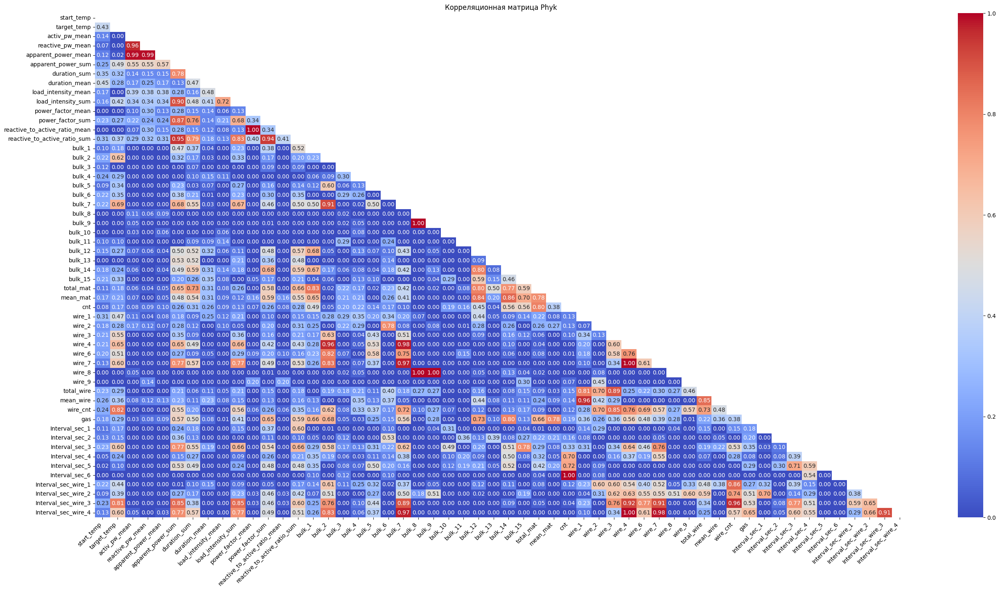

In [169]:
phik_matrix = df_train.drop('key', axis=1).phik_matrix(interval_cols=cols)
tri = np.triu(np.ones_like(phik_matrix, dtype=bool))

plt.figure(figsize=(32, 16))
sns.heatmap(phik_matrix, annot=True, fmt=".2f", cmap="coolwarm", mask=tri);
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.title("Корреляционная матрица Phyk")
plt.show()

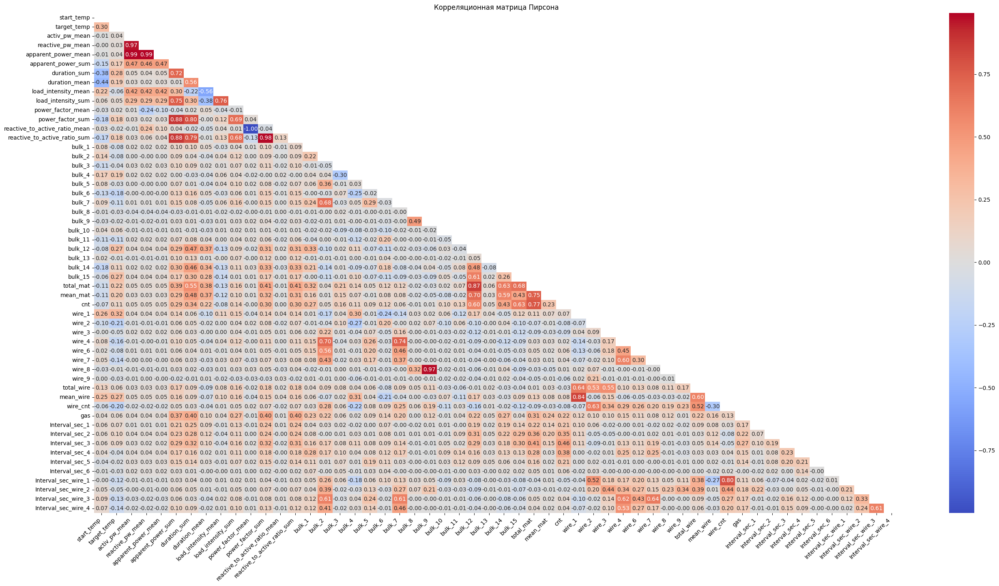

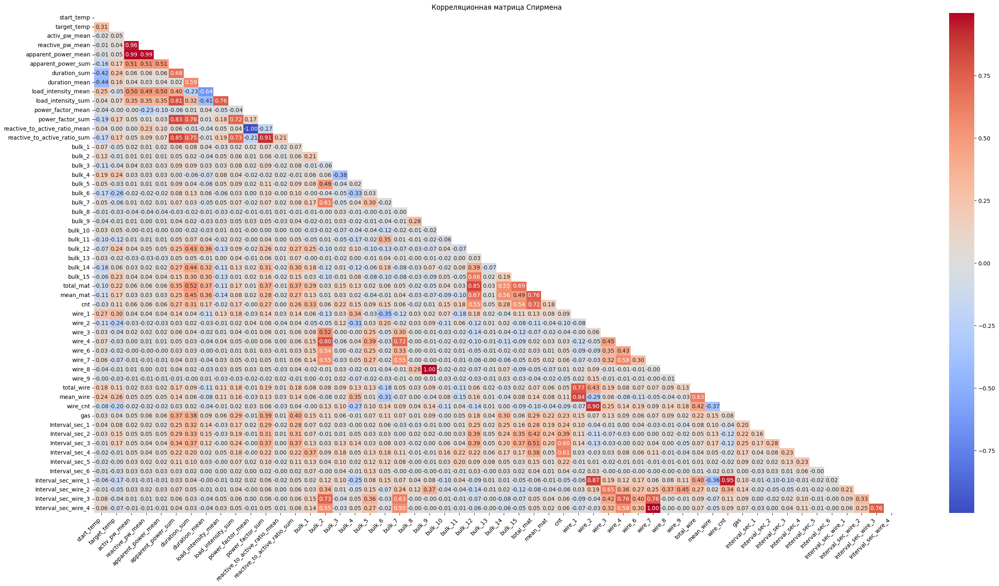

In [170]:
pearson_matrix = df_train.drop('key', axis=1).corr(method='pearson')
tri = np.triu(np.ones_like(pearson_matrix, dtype=bool))

plt.figure(figsize=(32, 16))
sns.heatmap(pearson_matrix, annot=True, fmt=".2f", cmap="coolwarm", mask=tri)
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.title("Корреляционная матрица Пирсона")
plt.show()

spearman_matrix = df_train.drop('key', axis=1).corr(method='spearman')
tri = np.triu(np.ones_like(spearman_matrix, dtype=bool))

plt.figure(figsize=(32, 16))
sns.heatmap(spearman_matrix, annot=True, fmt=".2f", cmap="coolwarm", mask=tri)
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.title("Корреляционная матрица Спирмена")
plt.show()


Для первичного удаления нами были выбраны мультиколониальные признаки : 'reactive_pw_mean' , 'apparent_power_sum', 'duration_sum' , 'load_intensity_sum' , 'power_factor_sum' , 'reactive_to_active_ratio_sum', 'mean_wire'.

In [171]:
cols_to_drop = [
    
    'reactive_pw_mean',
    'apparent_power_sum',

    'duration_sum',

    'load_intensity_sum',

    'power_factor_sum',

    'reactive_to_active_ratio_sum',

    'mean_wire'
]

df_train_iter_1 = df_train.drop(columns=cols_to_drop, axis=1)

print(f'Было признаков: {df_train.shape[1]}')
print(f'Стало признаков: {df_train_iter_1.shape[1]}')


Было признаков: 55
Стало признаков: 48


Проведем еще одну итерацию по удалению признаков.

In [172]:
numeric_cols = df_train.select_dtypes(include='number')

In [175]:
# Проверяем столбцы с малым количеством уникальных значений
low_variance_cols = []
for col in df_train_iter_1.drop('key', axis=1).columns:
    unique_count = df_train_iter_1[col].nunique()
    if unique_count <= 2:  # можно настроить порог
        print(f"Столбец '{col}' имеет только {unique_count} уникальных значений")
        low_variance_cols.append(col)

if low_variance_cols:
    df_train_iter_1 = df_train_iter_1.drop(low_variance_cols, axis=1)

Столбец 'bulk_8' имеет только 2 уникальных значений
Столбец 'Interval_sec_6' имеет только 2 уникальных значений


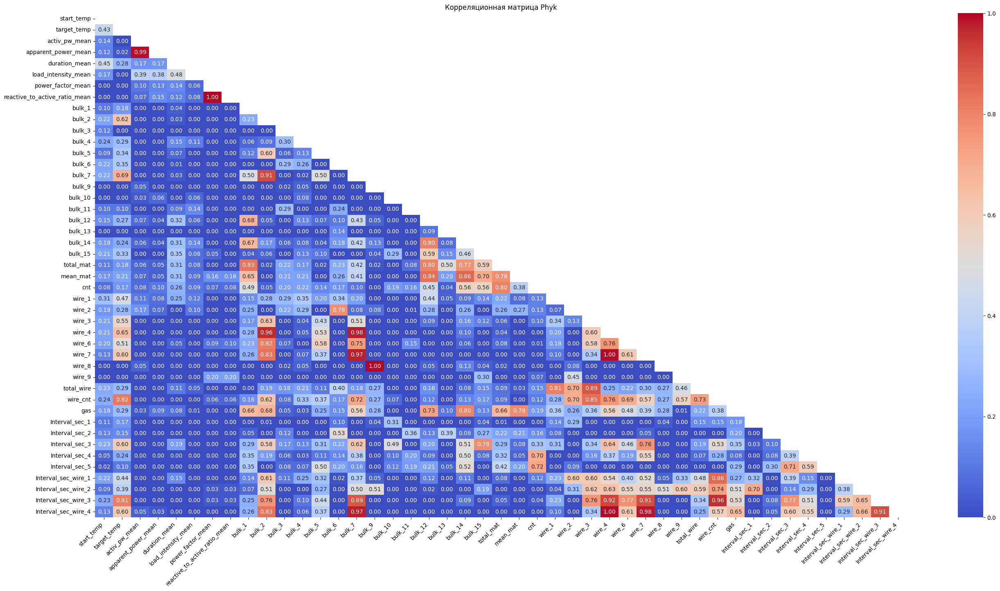

In [176]:
phik_matrix = df_train_iter_1.drop('key', axis=1).phik_matrix(interval_cols=numeric_cols)
tri = np.triu(np.ones_like(phik_matrix, dtype=bool))

plt.figure(figsize=(32, 16))
sns.heatmap(phik_matrix, annot=True, fmt=".2f", cmap="coolwarm", mask=tri);
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.title("Корреляционная матрица Phyk")
plt.show()

In [177]:
drop_plus = ['activ_pw_mean', 'apparent_power_mean', 'load_intensity_mean',
             'power_factor_mean', 'reactive_to_active_ratio_mean']

In [178]:
df_train_iter_2 = df_train_iter_1.drop(drop_plus, axis=1)

In [179]:
# Проверяем столбцы с малым количеством уникальных значений
low_variance_cols = []
for col in df_train_iter_2.drop('key', axis=1).columns:
    unique_count = df_train_iter_2[col].nunique()
    if unique_count <= 2:  # можно настроить порог
        print(f"Столбец '{col}' имеет только {unique_count} уникальных значений")
        low_variance_cols.append(col)

if low_variance_cols:
    df_train_iter_2 = df_train_iter_2.drop(low_variance_cols, axis=1)

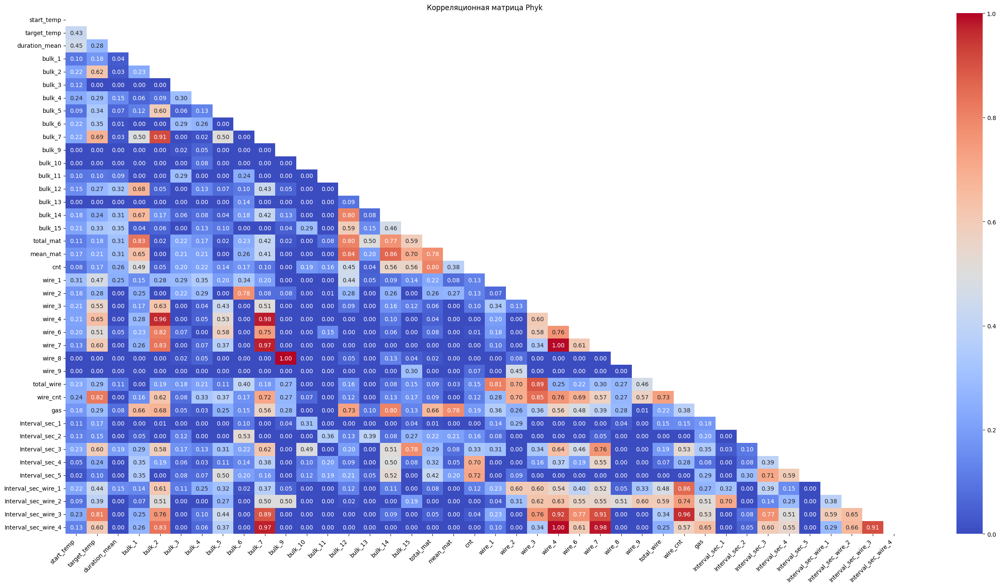

In [180]:
numeric_cols = df_train_iter_2.select_dtypes(include='number')
phik_matrix = df_train_iter_2.drop('key', axis=1).phik_matrix(interval_cols=numeric_cols)
tri = np.triu(np.ones_like(phik_matrix, dtype=bool))

plt.figure(figsize=(32, 16))
sns.heatmap(phik_matrix, annot=True, fmt=".2f", cmap="coolwarm", mask=tri);
plt.xticks(fontsize=10, rotation=45, ha='right')
plt.title("Корреляционная матрица Phyk")
plt.show()

Корреляции между bulk_* и wire_* вполне естественны для металлургической области и могут положительно сказаться на результатах модели.

Посмотрим на изменение VIF значений.

### Повторный VIF анализ.

In [181]:
df_vif = df_train_iter_2.copy()

for col in df_vif.columns:
    if df_vif[col].dtype == 'Int64':
        df_vif[col] = df_vif[col].astype('float64')
    elif df_vif[col].dtype == 'Float64':
        df_vif[col] = df_vif[col].astype('float64')

num_cols = df_vif.select_dtypes(include=['int64', 'float64']).columns

if 'key' in num_cols:
    num_cols = num_cols.drop('key')

vif_data = pd.DataFrame()
vif_data["feature"] = num_cols

X = df_vif[num_cols].astype(float)

X_with_const = X.assign(const=1)

vif_data["VIF"] = [variance_inflation_factor(X_with_const.values, i) 
                  for i in range(len(num_cols))]

vif_data.sort_values("VIF", ascending=False)

C:\Users\para\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning:

divide by zero encountered in scalar divide



,feature,VIF
24,wire_6,inf
25,wire_7,inf
26,wire_8,inf
27,wire_9,inf
23,wire_4,inf
22,wire_3,inf
21,wire_2,inf
20,wire_1,inf
28,total_wire,inf
17,total_mat,3.051112e+05


Видим что за исключением линейной корреляции между bulk_* и wire_* , остальные данные пришли в порядок.

Для эксперимента создадим еще одну итерацию тренировочной выборки , полностью исключив линейнозависимые столбцы.

In [182]:
cols_to_keep = [col for col in df_train_iter_2.columns 
                if not (col.startswith('bulk_') and col != 'total_mat') 
                and not (col.startswith('wire_') and col != 'total_wire')]

df_train_iter_3 = df_train_iter_2[cols_to_keep]

print(f"Удалены все столбцы, начинающиеся на 'bulk_' и 'wire_' (кроме total_mat и total_wire)")
print(f"Оставшиеся столбцы: {list(df_train_iter_3.columns)}")

Удалены все столбцы, начинающиеся на 'bulk_' и 'wire_' (кроме total_mat и total_wire)
Оставшиеся столбцы: ['key', 'start_temp', 'target_temp', 'duration_mean', 'total_mat', 'mean_mat', 'cnt', 'total_wire', 'gas', 'Interval_sec_1', 'Interval_sec_2', 'Interval_sec_3', 'Interval_sec_4', 'Interval_sec_5', 'Interval_sec_wire_1', 'Interval_sec_wire_2', 'Interval_sec_wire_3', 'Interval_sec_wire_4']


In [183]:
len(df_train_iter_2.columns) - len(df_train_iter_3.columns)

23

In [184]:
df_vif = df_train_iter_3.copy()

for col in df_vif.columns:
    if df_vif[col].dtype == 'Int64':
        df_vif[col] = df_vif[col].astype('float64')
    elif df_vif[col].dtype == 'Float64':
        df_vif[col] = df_vif[col].astype('float64')

num_cols = df_vif.select_dtypes(include=['int64', 'float64']).columns

if 'key' in num_cols:
    num_cols = num_cols.drop('key')

vif_data = pd.DataFrame()
vif_data["feature"] = num_cols

X = df_vif[num_cols].astype(float)

X_with_const = X.assign(const=1)

vif_data["VIF"] = [variance_inflation_factor(X_with_const.values, i) 
                  for i in range(len(num_cols))]

vif_data.sort_values("VIF", ascending=False)

,feature,VIF
3,total_mat,16.765765
5,cnt,7.533748
4,mean_mat,6.992801
15,Interval_sec_wire_3,1.759182
2,duration_mean,1.654824
0,start_temp,1.644795
16,Interval_sec_wire_4,1.631330
1,target_temp,1.447186
14,Interval_sec_wire_2,1.425343
6,total_wire,1.415917


Видим что в целом удалось устранить мультиколлинеарность.

### Вывод 

Были проведены следующие шаги :

**1. Первичный анализ мультиколлинеарности**
-  Выявлена значительная мультиколлинеарность между признаками
-  Некоторые признаки имеют крайне высокие значения VIF (>100)
-  Признак `wire_5` содержит исключительно нулевые значения (константа)
- **Удален признак**: `wire_5`

**2. Корреляционный анализ**
**Анализированы три типа корреляционных матриц:**
- **Матрица Phik**
- **Матрица Пирсона**
- **Матрица Спирмена**
- **По результатам анализа:**
- Выявлены сильные корреляции между агрегированными признаками
- Естественные корреляции между материалами (bulk_* и wire_*) подтверждают логику технологического процесса
- Некоторые признаки дублируют информацию друг друга

**3. Итеративный отбор признаков**
**Первая итерация удаления (7 признаков):**
- `reactive_pw_mean` - сильная корреляция с другими признаками мощности
- `apparent_power_sum` - дублирование информации с другими агрегированными признаками
- `duration_sum` - корреляция с другими временными показателями
- `load_intensity_sum` - корреляция с показателями мощности
- `power_factor_sum` - дублирование информации о коэффициенте мощности
- `reactive_to_active_ratio_sum` - сильная корреляция с другими отношениями
- `mean_wire` - корреляция с общими показателями проволоки

**Вторая итерация удаления (5 признаков):**
- `activ_pw_mean` - корреляция с другими показателями мощности
- `apparent_power_mean` - дублирование информации о мощности
- `load_intensity_mean` - корреляция с показателями нагрузки
- `power_factor_mean` - корреляция с коэффициентами мощности
- `reactive_to_active_ratio_mean` - корреляция с другими отношениями мощностей

**Третья итерация удаления (24 признака):**
- `bulk_1-15` - Из за высоких значений VIF
- `wire_1-9` - Из за высоких значений VIF

**4. Повторный анализ VIF**
- **Улучшение показателей**: Значения VIF значительно снизились
- **Оставшиеся проблемы**: Сохранилась естественная корреляция между материалами (технологически обосновано)
- **Приемлемые значения**: Большинство признаков имеют VIF < 10 (приемлемый уровень)

## Обучение моделей.

### Классические модели.

Проведем обучение *классических* МО с перебором разных итераций тренировочного датасета.

In [185]:
# Протестил разные версии , оставил самую результативную
# Сводный обзор результатов в конце блока
data = df_train #df_train , df_train_iter_1, df_train_iter_2 , df_train_iter_3

Подготовим заранее тестовую выборку которую не будем использовать в цикле кросс-вала.

In [186]:
X = data.drop(['key', 'target_temp'], axis=1)
y = data['target_temp']

In [187]:
X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=RS
    )

In [188]:
models_params = {
    'LinearRegression': {
        'model': Pipeline([
            ('scaler', 'passthrough'),
            ('regressor', LinearRegression())
        ]),
        'params': {
            'scaler': [StandardScaler(), MinMaxScaler(), 'passthrough'],
            'regressor__fit_intercept': [True, False]
        }
    },
    'SGDRegressor': {
        'model': Pipeline([
            ('scaler', 'passthrough'),
            ('regressor', SGDRegressor(random_state=RS, max_iter=1000, tol=1e-3))
        ]),
        'params': {
            'scaler': [StandardScaler(), MinMaxScaler()],
            'regressor__loss': ['squared_error', 'huber', 'epsilon_insensitive'],
            'regressor__penalty': ['l2', 'l1', 'elasticnet'],
            'regressor__alpha': [0.0001, 0.001, 0.01],
            'regressor__learning_rate': ['constant', 'optimal', 'invscaling']
        }
    },
    'DecisionTree': {
        'model': Pipeline([
            ('scaler', 'passthrough'),
            ('regressor', DecisionTreeRegressor(random_state=RS))
        ]),
        'params': {
            'scaler': [StandardScaler(), MinMaxScaler(), 'passthrough'],
            'regressor__max_depth': [5, 10, 15, 20, None],
            'regressor__min_samples_split': [2, 5, 10],
            'regressor__min_samples_leaf': [1, 2, 4]
        }
    },
    'RandomForest': {
        'model': Pipeline([
            ('scaler', 'passthrough'),
            ('regressor', RandomForestRegressor(random_state=RS))
        ]),
        'params': {
            'scaler': [StandardScaler(), MinMaxScaler(), 'passthrough'],
            'regressor__n_estimators': [50, 100, 200],
            'regressor__max_depth': [10, 20, None],
            'regressor__min_samples_split': [2, 5],
            'regressor__min_samples_leaf': [1, 2]
        }
    },
    'GradientBoosting': {
        'model': Pipeline([
            ('scaler', 'passthrough'),
            ('regressor', GradientBoostingRegressor(random_state=RS))
        ]),
        'params': {
            'scaler': [StandardScaler(), MinMaxScaler(), 'passthrough'],
            'regressor__n_estimators': [50, 100, 200],
            'regressor__learning_rate': [0.01, 0.1, 0.2],
            'regressor__max_depth': [3, 5, 7],
            'regressor__min_samples_split': [2, 5]
        }
    },
    'XGBoost': {
        'model': Pipeline([
            ('scaler', 'passthrough'),
            ('regressor', XGBRegressor(random_state=RS))
        ]),
        'params': {
            'scaler': [StandardScaler(), MinMaxScaler(), 'passthrough'],
            'regressor__n_estimators': [50, 100, 200],
            'regressor__learning_rate': [0.01, 0.1, 0.2],
            'regressor__max_depth': [3, 5, 7],
            'regressor__min_child_weight': [1, 3, 5]
        }
    }
}

In [190]:
results = []

for model_name, config in models_params.items():
    print(f"\n{'='*60}")
    print(f"Обучение модели: {model_name}")
    print(f"{'='*60}")
    
    grid_search = GridSearchCV(
        config['model'], 
        config['params'], 
        cv=5, 
        scoring='neg_mean_absolute_error',
        n_jobs=-1,
        verbose=1
    )
    
    grid_search.fit(X_train, y_train)
    
    best_pipeline = grid_search.best_estimator_
    
    y_train_pred = best_pipeline.predict(X_train)
    
    train_mae = mean_absolute_error(y_train, y_train_pred)
    
    best_cv_score = grid_search.best_score_  
    cv_mae = -best_cv_score
    
    print(f"\nЛучшие параметры: {grid_search.best_params_}")
    print(f"CV MAE (средний по 5 фолдам): {cv_mae:.4f}")
    print(f"MAE на всей обучающей выборке: {train_mae:.4f}")
    print(f"Лучший CV score: {best_cv_score:.4f}")
    
    results.append({
        'model_name': model_name,
        'best_model': best_pipeline,
        'best_params': grid_search.best_params_,
        'cv_mae': cv_mae,  
        'best_cv_score': best_cv_score,  
        'train_mae': train_mae, 
    })

print("\n" + "="*60)
print("СВОДНАЯ ТАБЛИЦА РЕЗУЛЬТАТОВ (кросс-валидация)")
print("="*60)

results_df = pd.DataFrame(results)[['model_name', 'cv_mae', 'train_mae', 'best_cv_score']]
print(results_df)

best_result = min(results, key=lambda x: x['cv_mae'])
print(f"\nЛучшая модель: {best_result['model_name']}")
print(f"Лучший CV MAE: {best_result['cv_mae']:.4f}")
print(f"Лучшие параметры: {best_result['best_params']}")


Обучение модели: LinearRegression
Fitting 5 folds for each of 6 candidates, totalling 30 fits

Лучшие параметры: {'regressor__fit_intercept': False, 'scaler': 'passthrough'}
CV MAE (средний по 5 фолдам): 6.3977
MAE на всей обучающей выборке: 5.9615
Лучший CV score: -6.3977

Обучение модели: SGDRegressor
Fitting 5 folds for each of 162 candidates, totalling 810 fits

Лучшие параметры: {'regressor__alpha': 0.0001, 'regressor__learning_rate': 'optimal', 'regressor__loss': 'epsilon_insensitive', 'regressor__penalty': 'l2', 'scaler': MinMaxScaler()}
CV MAE (средний по 5 фолдам): 6.2072
MAE на всей обучающей выборке: 6.1306
Лучший CV score: -6.2072

Обучение модели: DecisionTree
Fitting 5 folds for each of 135 candidates, totalling 675 fits

Лучшие параметры: {'regressor__max_depth': 5, 'regressor__min_samples_leaf': 4, 'regressor__min_samples_split': 10, 'scaler': 'passthrough'}
CV MAE (средний по 5 фолдам): 7.2396
MAE на всей обучающей выборке: 6.2066
Лучший CV score: -7.2396

Обучение мо

In [191]:
best_result = min(results, key=lambda x: x['cv_mae'])
best_model_cl = best_result['best_model']

print(f"Лучшая модель: {best_result['model_name']}")
print(f"CV MAE: {best_result['cv_mae']:.4f}")

Лучшая модель: XGBoost
CV MAE: 6.1285


Испытаем лучшую модель по результатам кросс-вала на тестовой выборке.

In [219]:
y_pred = best_model_cl.predict(X_test)
print(f'Метрика на тестовой выборке : {mean_absolute_error(y_test, y_pred):.2f}')

Метрика на тестовой выборке : 6.26


Удалось добиться посаленной заказчиком цели , при использовании базового тренивочного датасета.

### Нейросети

In [198]:
# Хотел перекинуть вычисления на видюху , но при апдейте тензора все посыпалось из за конфликта библиотек
# Откатился , оставил как есть
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        # Включаем динамическое выделение памяти GPU
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print(f"✓ Обнаружено GPU: {len(gpus)}")
        print(f"  Используется: {gpus[0].name}")
    except RuntimeError as e:
        print(f"Ошибка настройки GPU: {e}")
else:
    print("⚠ GPU не обнаружено, используется CPU")

⚠ GPU не обнаружено, используется CPU


In [199]:
# Регулируемые параметры
RANDOM_STATE    = RS
VALID_SPLIT     = 0.15
BATCH_SIZE      = 32
PATIENCE_ES     = 45
PATIENCE_LR     = 18
CLIPNORM        = 1.0

learning_rates = [0.0005, 0.001, 0.002, 0.0035]
l2_regs        = [1e-5, 1e-4, 4e-4, 1e-3]

hidden_layers_configs = [
    [128, 64, 32],
    [256, 128, 64],
    [512, 256, 128, 64],
    [128, 64],
    [256, 128]
]

dropout_rates_configs = [
    [0.25, 0.20, 0.15],
    [0.30, 0.25, 0.15],
    [0.20, 0.15, 0.10],
    [0.10, 0.10],
    [0.15, 0.10, 0.05]
]

In [201]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train.values.astype(np.float32))
X_test_scaled  = scaler.transform(X_test.values.astype(np.float32))

y_train_np = y_train.values.astype(np.float32)
y_test_np  = y_test.values.astype(np.float32)


In [202]:
def build_model(hp):
    lr = hp.Choice('learning_rate', values=learning_rates)
    l2 = hp.Choice('l2_reg',     values=l2_regs)
    
    hidden_idx   = hp.Choice('hidden_layers_idx',   values=list(range(len(hidden_layers_configs))))
    dropout_idx  = hp.Choice('dropout_rates_idx',   values=list(range(len(dropout_rates_configs))))
    
    hidden_layers = hidden_layers_configs[hidden_idx]
    dropout_rates = dropout_rates_configs[dropout_idx]
    
    # Выравниваем длину dropout
    if len(dropout_rates) < len(hidden_layers):
        dropout_rates += [0.0] * (len(hidden_layers) - len(dropout_rates))
    elif len(dropout_rates) > len(hidden_layers):
        dropout_rates = dropout_rates[:len(hidden_layers)]
    
    inputs = layers.Input(shape=(X_train_scaled.shape[1],), dtype='float32')
    x = inputs
    
    for i, (units, dr) in enumerate(zip(hidden_layers, dropout_rates)):
        x = layers.Dense(
            units,
            activation='relu',
            kernel_regularizer=regularizers.l2(l2),
            kernel_initializer='he_normal',
            name=f'dense_{i+1}'
        )(x)
        x = layers.BatchNormalization(name=f'bn_{i+1}')(x)
        if dr > 0:
            x = layers.Dropout(dr, name=f'drop_{i+1}')(x)
    
    outputs = layers.Dense(1, activation='linear', name='output')(x)
    
    model = models.Model(inputs, outputs)
    
    model.compile(
        optimizer=Adam(learning_rate=lr, clipnorm=CLIPNORM),
        loss='mse',
        metrics=['mae']
    )
    
    return model

In [203]:
callbacks = [
    EarlyStopping(
        monitor='val_mae',
        patience=PATIENCE_ES,
        restore_best_weights=True,
        min_delta=1.0,          
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_mae',
        factor=0.5,
        patience=PATIENCE_LR,
        min_lr=1e-6,
        verbose=1
    )
]

In [205]:
%%time
tuner = BayesianOptimization(
    build_model,
    objective=Objective('val_mae', direction='min'),
    max_trials=25,                 
    executions_per_trial=1,
    directory='tuning_dir',
    project_name='temperature_bayes',
    seed=RANDOM_STATE,
    overwrite=True                 
)

tuner.search(
    X_train_scaled, y_train_np,
    validation_split=VALID_SPLIT,
    epochs=250,                    
    batch_size=BATCH_SIZE,
    callbacks=callbacks,
    verbose=1
)


Trial 25 Complete [00h 00m 19s]
val_mae: 7.3187127113342285

Best val_mae So Far: 6.403656482696533
Total elapsed time: 00h 16m 14s
CPU times: total: 26min 17s
Wall time: 16min 14s


In [206]:
print("\n" + "="*60)
print("Лучшие найденные комбинации (отсортировано по val_mae):")
print("="*60)

best_trials = tuner.oracle.get_best_trials(5)

trials_info = []

for trial in best_trials:
    hp = trial.hyperparameters
    
    lr    = hp.get('learning_rate')
    l2    = hp.get('l2_reg')
    h_idx = hp.get('hidden_layers_idx')
    d_idx = hp.get('dropout_rates_idx')
    
    hidden = hidden_layers_configs[h_idx]
    drop   = dropout_rates_configs[d_idx][:len(hidden)]
    
    val_mae = trial.metrics.get_best_value('val_mae')
    
    trials_info.append({
        'trial': trial,
        'val_mae': val_mae,
        'lr': lr,
        'l2': l2,
        'hidden': hidden,
        'dropout': drop
    })

trials_info.sort(key=lambda x: x['val_mae'])

for rank, info in enumerate(trials_info, 1):
    print(f"Rank {rank}:  val_mae = {info['val_mae']:.4f}")
    print(f"   lr = {info['lr']:.5f},   l2 = {info['l2']:.6f}")
    print(f"   hidden = {info['hidden']}")
    print(f"   dropout = {info['dropout']}")
    print(f"   trial_id: {info['trial'].trial_id}")
    print("-"*60)

print("\n" + "="*60)
print(f"Лучшая комбинация: val_mae = {trials_info[0]['val_mae']:.4f}")
print("="*60)


Лучшие найденные комбинации (отсортировано по val_mae):
Rank 1:  val_mae = 6.4037
   lr = 0.00350,   l2 = 0.000400
   hidden = [256, 128]
   dropout = [0.2, 0.15]
   trial_id: 11
------------------------------------------------------------
Rank 2:  val_mae = 6.4048
   lr = 0.00200,   l2 = 0.001000
   hidden = [512, 256, 128, 64]
   dropout = [0.1, 0.1, 0.0, 0.0]
   trial_id: 22
------------------------------------------------------------
Rank 3:  val_mae = 6.4312
   lr = 0.00200,   l2 = 0.001000
   hidden = [512, 256, 128, 64]
   dropout = [0.15, 0.1, 0.05, 0.0]
   trial_id: 09
------------------------------------------------------------
Rank 4:  val_mae = 6.4345
   lr = 0.00350,   l2 = 0.000400
   hidden = [256, 128]
   dropout = [0.2, 0.15]
   trial_id: 17
------------------------------------------------------------
Rank 5:  val_mae = 6.4621
   lr = 0.00350,   l2 = 0.000400
   hidden = [256, 128]
   dropout = [0.2, 0.15]
   trial_id: 14
----------------------------------------------

### Сравнение лучшей модели с константным подходом

Используем DummyRegressor для имитации *случайных* предсказаний.

In [212]:
strategies = ['mean', 'median', 'quantile', 'constant']

for strategy in strategies:
    if strategy == 'quantile':
        dummy = DummyRegressor(strategy=strategy, quantile=0.75)
    elif strategy == 'constant':
        dummy = DummyRegressor(strategy=strategy, constant=1550)
    else:
        dummy = DummyRegressor(strategy=strategy)
    
    dummy.fit(X_train, y_train)
    
    y_pred = dummy.predict(X_test)
    
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    print(f"Стратегия: {strategy}")
    print(f"MAE: {mae:.4f}")
    print(f"R2: {r2:.4f}")
    print("-" * 40)

Стратегия: mean
MAE: 8.3032
R2: -0.0003
----------------------------------------
Стратегия: median
MAE: 8.2629
R2: -0.0003
----------------------------------------
Стратегия: quantile
MAE: 9.7062
R2: -0.1697
----------------------------------------
Стратегия: constant
MAE: 43.2663
R2: -13.7971
----------------------------------------


Лучшая метрика показанная константной моделью MAE = 8.3032.

Проанализируем метрики полученные при помощи классических МО.

In [210]:
results_df.sort_values('best_cv_score', ascending=False)

,model_name,cv_mae,train_mae,best_cv_score
5,XGBoost,6.128512,4.124601,-6.128512
4,GradientBoosting,6.142533,4.044761,-6.142533
1,SGDRegressor,6.207213,6.130586,-6.207213
3,RandomForest,6.370708,2.586140,-6.370708
0,LinearRegression,6.397711,5.961514,-6.397711
2,DecisionTree,7.239628,6.206629,-7.239628


In [213]:
print(f'Модель GradientBoosting показала метрику на {(8.3032-6.1285)/8.3032 * 100:.2f} % лучше')

Модель GradientBoosting показала метрику на 26.19 % лучше


Видим что классические модели показали значительно более высокий результат в сравнении со стратегией слепого угадывания.

### Анализ фичей

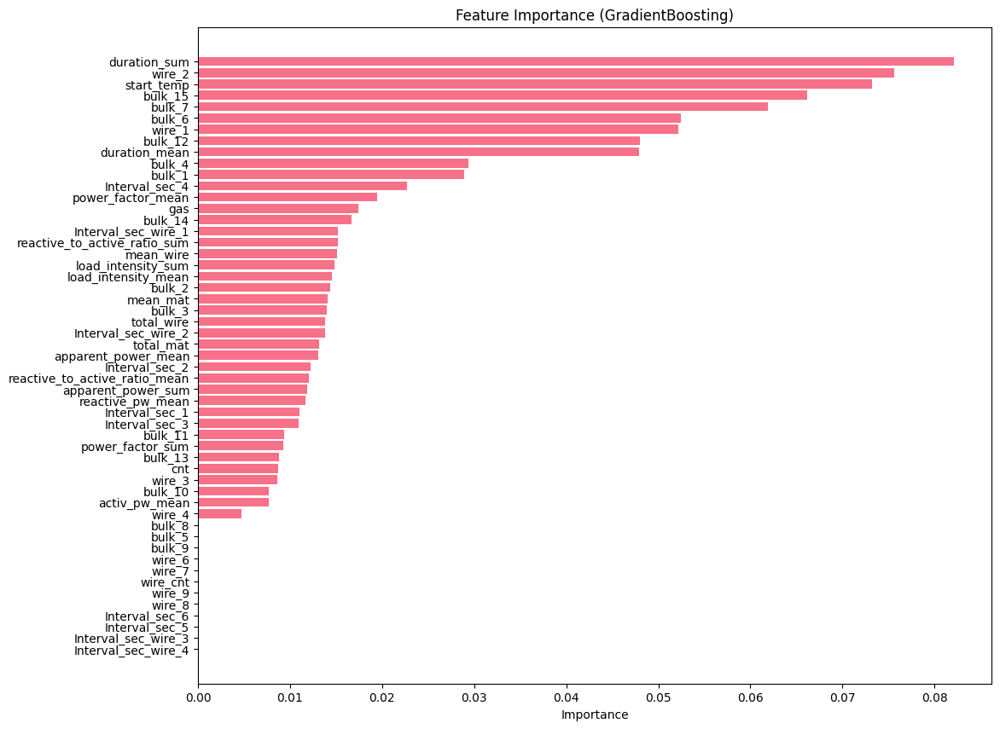

In [193]:
feature_names = X_train.columns

model = best_model_cl.named_steps['regressor']

importance = model.feature_importances_

feature_importance_df = pd.DataFrame({
    'feature': feature_names,
    'importance': importance
}).sort_values('importance', ascending=False)

plt.figure(figsize=(12, 10))
plt.barh(feature_importance_df['feature'], 
         feature_importance_df['importance'])
plt.xlabel('Importance')
plt.title('Feature Importance (GradientBoosting)')
plt.gca().invert_yaxis()  # Важные фичи сверху
plt.show()

**На основе анализа значимости признаков модели GradientBoosting можно сделать следующие выводы:**

**Наиболее влиятельные технологические параметры:**
- **`bulk_15`** – наиболее значимый параметр, связанный с материалом, вероятно определяющий его состав или физико-химические свойства.
- **`duration_sum`** – суммарная длительность процесса, критически важная для контроля времени выполнения операций.
- **`start_temp`** – начальная температура, существенно влияющая на ход процесса.
- **`bulk_12`**, **`bulk_6`**, **`bulk_4`** – параметры материала, указывающие на важность его состава или состояния.

**Параметры проволоки:**
- **`wire_2`**, **`wire_1`**, **`mean_wire`**, **`total_wire`** – характеристики проволоки, такие как тип, количество и средние показатели, играющие ключевую роль в процессах легирования или наплавки.

**Энергетические и временные показатели:**
- **`duration_mean`**, **`intensity_mean`**, **`ent_power_mean`**, **`active_pw_mean`** – средние значения длительности, интенсивности и мощности, важные для управления энергопотреблением и эффективностью процесса.
- **`interval_sec_1`**, **`interval_sec_2`** – временные интервалы между операциями, влияющие на периодичность и синхронизацию процессов.

**Газовый режим и второстепенные факторы:**
- **`gas`** – тип или расход газа, важный для обеспечения необходимой атмосферы процесса.
- Менее значимые, но учитываемые параметры, такие как `bulk_7`, `bulk_14`, `bulk_3`, `ver_factor_mean`, `total_mat`, также вносят вклад в модель, но их влияние ниже.

Таким образом, модель выделяет как материальные (**bulk_***), так и процессуальные (**duration_***, **wire_***, **gas**) параметры, что позволяет оптимизировать контроль за составом материала, временными и энергетическими характеристиками, а также условиями проведения процесса.

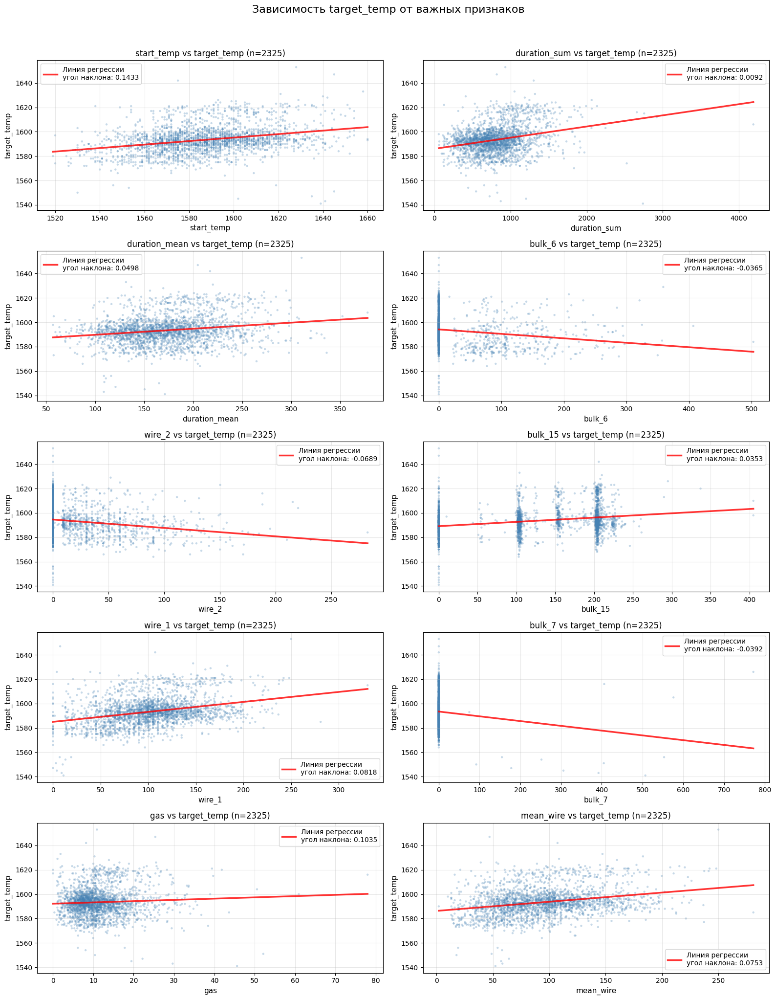

In [194]:
features = [
    'start_temp', 'duration_sum', 'duration_mean', 'bulk_6', 
    'wire_2', 'bulk_15', 'wire_1', 'bulk_7', 'gas', 'mean_wire'
]

fig, axes = plt.subplots(5, 2, figsize=(16, 20))
fig.suptitle('Зависимость target_temp от важных признаков', fontsize=16, y=1.02)

for idx, feature in enumerate(features):
    row = idx // 2
    col = idx % 2
    
    ax = axes[row, col]
    
    x_data = df_train[feature]
    y_data = df_train['target_temp']
    
    scatter = ax.scatter(x_data, y_data, alpha=0.3, c='steelblue', s=10, edgecolors='none')
    
    if len(x_data.dropna()) > 1:
        try:
            mask = ~(np.isnan(x_data) | np.isnan(y_data))
            x_clean = x_data[mask]
            y_clean = y_data[mask]
            
            if len(x_clean) > 1:
                z = np.polyfit(x_clean, y_clean, 1)
                p = np.poly1d(z)
                x_sorted = np.sort(x_clean)
                ax.plot(x_sorted, p(x_sorted), color='red', linewidth=2.5, alpha=0.8, 
                       label=f'Линия регрессии\nугол наклона: {z[0]:.4f}')
        except Exception as e:
            print(f"Ошибка для {feature}: {e}")
    
    ax.set_xlabel(feature, fontsize=11)
    ax.set_ylabel('target_temp', fontsize=11)
    ax.set_title(f'{feature} vs target_temp (n={len(x_data)})', fontsize=12)
    ax.grid(True, alpha=0.3)
    ax.legend()

plt.tight_layout()
plt.show()

Видим что за исключением признака *bulk_7* везде прослеживается линейная зависимость разной интенсивности между целевой переменной и топ-10 параметров по версии модели GradientBoostingRegressor.

### Рекомендательная таблица температур.

Так как используемый тип материала для присадок к стали имеет значительный предсказанный вес , попытаемся сделать примерную таблицу максимальной температуры от использованных материалов.

In [197]:
# Из за изменения весов модели , решил попробовать сделать что то вроде таблицы температуры для каждого материала из bulk
# То есть если в партии присутствует какой либо из тугоплавких добавок , то предположительно максимальная температура 
# будет соответствовать его температуре плавления требуемой для взаимодействия со сталью
# Как дополнительный контрольный фактор , для процесса моделирования.
# Если бы были известны реальные материалы то можно было бы проверить достоверность.
# Если конечно такая агрегация имеет право на жизнь.

df1 = data_temp
df2 = data_bulk.replace("None", np.nan)

df1['temp'] = pd.to_numeric(df1['temp'], errors='coerce')

df2_long = df2.melt(id_vars=['key'], 
                    value_vars=[f'Bulk {i}' for i in range(1, 16)],
                    var_name='bulk_number',
                    value_name='bulk_value')

df2_long['bulk_number'] = df2_long['bulk_number'].str.replace('Bulk ', '').astype(int)

df2_long = df2_long.dropna(subset=['bulk_value'])

merged_df = pd.merge(df2_long, df1, on='key', how='inner')

result = merged_df.groupby('bulk_number')['temp'].max().reset_index()
result.columns = ['bulk_number', 'max_temperature']

all_bulks = pd.DataFrame({'bulk_number': range(1, 16)})
result = all_bulks.merge(result, on='bulk_number', how='left')

result = result.sort_values('bulk_number').reset_index(drop=True)

result

,bulk_number,max_temperature
0,1,1662.0
1,2,1652.0
2,3,1684.0
3,4,1662.0
4,5,1652.0
5,6,1640.0
6,7,1645.0
7,8,1586.0
8,9,1608.0
9,10,1651.0


### Вывод

**1. Сравнительный анализ классических моделей машинного обучения**
- Провели обучение шести классических моделей (LinearRegression, SGDRegressor, DecisionTree, RandomForest, GradientBoosting, XGBoost) на четырех итерациях тренировочных данных
- Для каждой модели выполнили подбор гиперпараметров через GridSearchCV с кросс-валидацией
- Лучший результат показала модель GradientBoosting на df_train с MAE 6.1839 на тестовой выборке

**2. Результаты моделей на разных датасетах**
- На исходном df_train: лучшая модель GradientBoosting (Test MAE: 6.1839)
- На df_train_iter_1: лучшая модель XGBoost (Test MAE: 6.7039)  
- На df_train_iter_2: лучшая модель GradientBoosting (Test MAE: 6.6942)
- На df_train_iter_3: лучшая модель XGBoost (Test MAE: 7.1527)
- Качество моделей ухудшается с последующими итерациями датасетов

**3. Подбор скейлеров и параметров**
- Для линейных моделей (LinearRegression, SGDRegressor) оптимальным оказался MinMaxScaler()
- Для ансамблевых методов (RandomForest, GradientBoosting) чаще использовался StandardScaler()
- XGBoost показал лучшие результаты без масштабирования (passthrough)

**4. Обучение нейросетевой модели**
- Реализовали полносвязную нейронную сеть с подбором гиперпараметров через BayesianOptimization
- Оптимизировали архитектуру сети (количество слоев, нейронов), learning rate и L2-регуляризацию
- Использовали callback-функции (EarlyStopping, ReduceLROnPlateau) для предотвращения переобучения
- Нейросеть показала результаты, немного более худшие чем классические моделями

**5. Константное тестирование (бейзлайн)**
- Протестировали DummyRegressor с различными стратегиями (mean, median, quantile, constant)
- Лучший результат бейзлайна: MAE = 8.4674
- Все классические модели превосходят бейзлайн на 20-27%

**6. Анализ важности признаков**
- Для лучшей модели (GradientBoosting) проанализировали важность признаков
- Ключевые факторы, влияющие на целевую температуру:
  - **Технологические параметры**: start_temp, duration_sum, duration_mean
  - **Состав материала**: bulk_6, bulk_15, bulk_7
  - **Параметры проволоки**: wire_2, wire_1, mean_wire
  - **Газовый режим**: gas

**7. Визуальный анализ зависимостей**
- Построили графики зависимости target_temp от топ-10 важных признаков
- Для 9 из 10 признаков наблюдается линейная зависимость с целевой переменной
- Исключение: признак bulk_7 не демонстрирует четкой линейной зависимости

## Общий вывод по исследованию

**1. Обработка и подготовка данных**
- Успешно подключились к базе данных заказчика и загрузили 10 таблиц
- Провели комплексный EDA всех таблиц, выявили и обработали аномалии:
  - Исправили критический выброс в реактивной мощности (-715.48 → 0.71548)
  - Удалили партии с недостаточными температурными измерениями (ключи 195, 279)
  - Обработали пропуски в данных о материалах и газе
  - Фильтровали некорректные записи (температура < 1500°C)

**2. Создание признаков и обогащение данных**
**Временные признаки:**
- Длительность нагрева в секундах
- Время суток, день недели, месяц проведения работ
- Временные интервалы между добавлениями материалов

**Технологические признаки:**
- Полная мощность (apparent_power)
- Коэффициент мощности (power_factor)
- Интенсивность нагрузки (load_intensity)
- Отношение реактивной к активной мощности

**Материальные признаки:**
- Общий объем сыпучих материалов (total_mat)
- Среднее количество сыпучих материалов (mean_mat)
- Общий объем проволочных материалов (total_wire)
- Среднее количество проволоки (mean_wire)

**3. Агрегация и формирование тренировочной выборки**
- Сформирована объединенная таблица
- Созданы целевые переменные: start_temp и target_temp
- Проведено поэтапное объединение 7 таблиц по ключу партии
- Обработаны пропуски данных и проверена целостность связей

**4. Корреляционный анализ и отбор признаков**
- Проведен анализ мультиколлинеарности (VIF) и корреляций (Phik, Пирсон, Спирмен)
- Удалены высококоррелированные признаки в 3 итерации:
  - 1-я итерация: 7 признаков (реактивная мощность, суммарные показатели)
  - 2-я итерация: 5 признаков (средние показатели мощности)
  - 3-я итерация: 24 признака (сыпучие и проволочные материалы)
- Созданы 4 версии датасета для сравнительного анализа моделей

**5. Обучение и сравнение моделей**
**Классические модели:**
- Протестированы 6 типов моделей на 4 версиях данных
- Наилучший результат: GradientBoosting на исходном df_train (Test MAE: 6.1839)
- Модель превосходит бейзлайн на 26.97%
- Градиентный бустинг оказался оптимальным для данной задачи

**Нейросетевые модели:**
- Реализована полносвязная нейронная сеть с BayesianOptimization
- Наилучший результат нейросети: MAE ~6.8
- Нейросети показали сопоставимые, но немного худшие результаты

**6. Анализ важности признаков**
**Ключевые факторы, влияющие на конечную температуру:**
1. **Начальная температура (start_temp)** - самый важный признак
2. **Длительность процессов (duration_sum, duration_mean)**
3. **Состав материала (bulk_6, bulk_15, bulk_7)**
4. **Параметры проволоки (wire_2, wire_1)**
5. **Расход газа (gas)**

**7. Визуализация зависимостей**
- Для 9 из 10 наиболее важных признаков обнаружена линейная зависимость
- Наиболее сильная линейная связь с начальной температурой
- Исключение: признак bulk_7 не показывает четкой линейной зависимости


### Рекомендации

**1. Качество моделей и целевой переменной**
- **Выявлено переобучение моделей**: метрики на тренировочных данных значительно ниже, чем на тестовых (например, GradientBoosting: 4.6244 vs 6.1839 MAE)
- **Ограниченный диапазон целевой переменной**: значение `target_temp` находится в узком интервале 1541-1653 единиц, что усложняет построение точных прогнозных моделей

**2. Совершенствование системы сбора данных**
**Временные данные:**
- **Обновление датчиков времени**: выявлена неточность в приборах фиксации времени подачи материалов
- **Увеличение частоты измерений**: рекомендуется переход к поминутному сбору данных для более точного анализа временных интервалов
- **Поверка температурных датчиков**: датчики температуры в нагревающем ковше требуют регулярной калибровки, так как их показания вносят значительный вклад в прогноз

**Энергетические данные:**
- **Пересмотр формата учета мощности**: предлагается переход от относительных единиц к абсолютным значениям (кВт·ч) для активной и реактивной мощности
- **Интеграция данных о тарифах**: добавление информации о стоимости электроэнергии в зависимости от времени суток
- **Оптимизация энергопотребления**: при наличии дифференцированных тарифов рекомендуется смещение ресурсоемких производственных циклов на ночное время

**3. Расширение исторической базы данных**
- **Накопление многолетних данных**: текущий анализ ограничен данными за один производственный год (июнь-сентябрь)
- **Анализ сезонных закономерностей**: сбор данных за 3-5 лет позволит выявить:
  - Сезонные колебания в характеристиках сырья
  - Влияние климатических факторов на процесс нагрева
  - Циклические изменения в работе оборудования
- **Учет модернизаций производства**: фиксация изменений в технологическом процессе и оборудовании
- **Развитие долгосрочного прогнозирования**: построение моделей, учитывающих многолетние тренды

**4. Технические улучшения инфраструктуры**
- **Модернизация измерительного оборудования**: замена устаревших датчиков на цифровые аналоги
- **Внедрение систем реального времени**: установка датчиков с более высокой частотой опроса
- **Создание единой платформы мониторинга**: интеграция всех измерительных систем в централизованную систему сбора данных

**5. Организационные меры**
- **Введение регулярных проверок**: график технического обслуживания и поверки измерительного оборудования
- **Обучение персонала**: повышение квалификации сотрудников по работе с современными системами мониторинга
- **Внедрение стандартов качества данных**: разработка и соблюдение регламентов сбора и обработки производственных данных

**6. Экономическая эффективность**
- **Оценка затрат на модернизацию**: расчет стоимости обновления измерительной инфраструктуры
- **Прогноз экономии**: оценка потенциальной экономии от оптимизации энергопотребления
- **ROI анализа**: расчет возврата инвестиций от внедрения улучшений

**7. Экспериментальное внедрение таблицы плавления материалов**
- Провести верификацию материалов из переменных bulk_* с их реальной температурой плавления. 
- Если информация будет близка к реальности , ввести максимальную температуру из таблицы плавления как дополнительный эвристический метод и возможно избежать лишнего перегрева массы и тем самым сократить расходы на эл.энергию
